## Détection Automatisée des Cellules Cancéreuses dans le Sang

## Problématique
Le  cancer  du  sang,  également  connu  sous  le  nom  de  leucémie,  est  l'un  des  types  de  cancer  les  plus 
répandus  dans  le  monde,  affectant  des  millions  de  personnes  chaque  année.  Un  diagnostic  précoce  et 
précis de cette maladie est crucial pour un traitement efficace et des résultats cliniques optimaux. Dans 
ce  contexte,  les  avancées  récentes  dans  le  domaine  de  l'intelligence  artificielle,  en  particulier  dans  le 
domaine de la vision par ordinateur et de l'apprentissage automatique, offrent de nouvelles possibilités 
pour la détection et la caractérisation des cellules cancéreuses dans les échantillons de sang.
### Introduction
Dans ce document, nous allons explorer l'implémentation de plusieurs modèles pour détecter les cellules sanguines malignes à partir d'images. Nous allons utiliser un ensemble de données provenant de Kaggle, dans le but de former un modèle capable de distinguer entre les cellules bénignes et malignes.

### Jeu do données
Le diagnostic définitif de la leucémie lymphoblastique aiguë (ALL), en tant que cancer très répandu, nécessite des tests de diagnostic invasifs, coûteux et longs. Le diagnostic de la LLA à partir d'images de frottis sanguins périphériques (PBS) joue un rôle vital dans le dépistage initial du cancer parmi les cas non cancéreux. L'examen de ces images PBS par les utilisateurs de laboratoire est parsemé de problèmes tels que l'erreur diagnostique car la nature non spécifique des signes et symptômes de la LLA conduit souvent à un mauvais diagnostic.
Les images de ce jeu de données ont été préparées dans le laboratoire de la moelle osseuse de l'hôpital Taleqani (Téhéran, Iran). Ce jeu de données se composait de 3242 images PBS de 89 patients suspectés de LLA, dont les échantillons de sang ont été préparés et colorés par du personnel de laboratoire qualifié. Ce jeu de données est divisé en deux classes bénigne et maligne. Le premier comprend des hématogènes, et le second est le groupe ALL avec trois sous-types de lymphoblastes malins: Early Pre-B, Pre-B et Pro-B ALL. Toutes les images ont été prises à l'aide d'un appareil photo Zeiss dans un microscope avec un grossissement de 100x et enregistrées sous forme de fichiers JPG. Un spécialiste utilisant l'outil de cytométrie en flux a fait la détermination définitive des types et sous-types de ces cellules.
- Early Pre-B : signifie que les cellules sont dans la phase précoce de la différenciation B.
- Pre-B : signifie que les cellules sont dans la phase intermédiaire de la différenciation B.
- Pro-B : signifie que les cellules sont dans la phase finale de la différenciation B.
- Benign : signifie que les cellules sont normales.

<!-- <img 
    src="https://imgs.search.brave.com/IVoTC_JJZzK1RlCqJA6OlGzT9JYHfe3iHwliD5_H3ls/rs:fit:860:0:0/g:ce/aHR0cHM6Ly93d3cu/bWFjbWlsbGFuLm9y/Zy51ay9kZnNtZWRp/YS8xYTZmMjM1Mzdm/N2Y0NTE5YmIwY2Yx/NGM0NWIyYTYyOS82/MjY4LTUwMDMzL21h/Y2QxNzAtYmxvb2Qt/Y2VsbHMtaW5jLWJs/YXN0LWNlbGxz"
    style="width: 500px; height: 300px"
 /> -->

## Bibliotèques

In [2]:
# Manipulation des données
# ===============================================================
import numpy as np
import pandas as pd

# Data Scaling
from sklearn.preprocessing import StandardScaler


# Traitement d'image
# ===============================================================
import cv2
from scipy import ndimage as ndi
from skimage import morphology
from skimage import io, color, filters, segmentation
from skimage.feature import graycomatrix, graycoprops, peak_local_max
from skimage.color import rgb2gray
from skimage.util import img_as_ubyte
from skimage.measure import label as sk_label 
from skimage.measure import regionprops
from skimage import measure
from skimage.segmentation import watershed
from imutils import paths

# Visualisation des données
# ===============================================================
from matplotlib.patches import Rectangle
import matplotlib.pyplot as plt
import seaborn as sns

# Entrainement
# ===============================================================
from sklearn.model_selection import train_test_split

# model 
# ===============================================================
from sklearn.cluster import KMeans

# Evaluation
# ===============================================================
from sklearn import metrics
from sklearn.metrics import mean_absolute_error,mean_squared_error


# Utilitaires
# ===============================================================
import time
import os
import random
import warnings
warnings.filterwarnings('ignore')


## Préparation du jeu de données

In [349]:
# le path du jeu de données
data_path = r'E:\projet_cv\Blood cell Cancer [ALL]'

In [350]:
categories = [category for category in os.listdir(data_path) if os.path.isdir(os.path.join(data_path, category))]
num_categories = len(categories)
print(f"Le jeu de données contient {num_categories} categories.")

Le jeu de données contient 4 categories.


Afficher une image aléatoire de chaque categorie

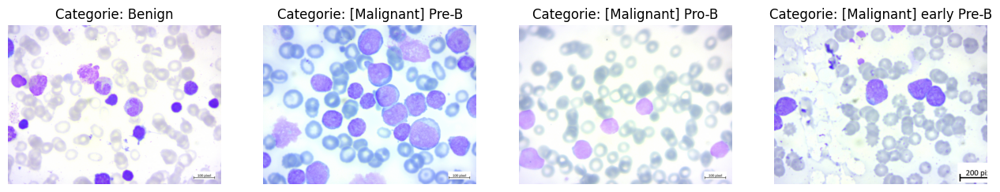

In [353]:
categories = [category for category in os.listdir(data_path) if os.path.isdir(os.path.join(data_path, category))]

fig, axs = plt.subplots(1, 4, figsize=(16, 4))

for ax, category in zip(axs, categories):
    random_image = random.choice(os.listdir(os.path.join(data_path, category)))
    random_image = cv2.imread(os.path.join(data_path, category, random_image))
    random_image = cv2.cvtColor(random_image, cv2.COLOR_BGR2RGB)
    ax.imshow(random_image)
    ax.set_title(f"Categorie: {category}")
    ax.axis('off')

Categorie: Benign, nombre des images: 512
Categorie: [Malignant] Pre-B, nombre des images: 955
Categorie: [Malignant] Pro-B, nombre des images: 796
Categorie: [Malignant] early Pre-B, nombre des images: 979
total des images : 3242


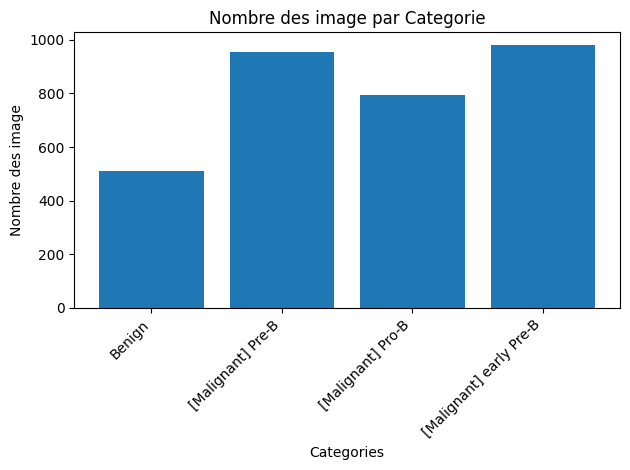

In [354]:
category_counts = {}

categories = [category for category in os.listdir(data_path) if os.path.isdir(os.path.join(data_path, category))]

for category in categories:
    category_dir = os.path.join(data_path, category)
    image_files = [filename for filename in os.listdir(category_dir) if filename.endswith(('.jpg'))]
    category_counts[category] = len(image_files)

for category, count in category_counts.items():
    print(f"Categorie: {category}, nombre des images: {count}")
    
print("total des images :" ,sum(category_counts.values()))

plt.bar(category_counts.keys(), category_counts.values())
plt.xlabel('Categories')
plt.ylabel('Nombre des image')
plt.title('Nombre des image par Categorie')
plt.xticks(rotation=45, ha='right')
plt.tight_layout()
plt.show()

In [355]:
img = cv2.imread(r'E:\projet_cv\Blood cell Cancer [ALL]\Benign\Sap_013 (10).jpg')
print('Size d\'image: '+str(img.shape))

Size d'image: (768, 1024, 3)


1- créer des dossier pour organiser notre jeu de données

In [ ]:
# vous pouvez commenter ce code pour créer les dossier

# !mkdir ..\data\train_data
# !mkdir ..\data\train_data\benign
# !mkdir ..\data\train_data\PreB
# !mkdir ..\data\train_data\ProB
# !mkdir ..\data\train_data\EarlyPreB

# !mkdir ..\data\test_data
# !mkdir ..\data\test_data\benign
# !mkdir ..\data\test_data\PreB
# !mkdir ..\data\test_data\ProB
# !mkdir ..\data\test_data\EarlyPreB

# !mkdir ..\data\segmented_train
# !mkdir ..\data\segmented_train\benign
# !mkdir ..\data\segmented_train\PreB
# !mkdir ..\data\segmented_train\ProB
# !mkdir ..\data\segmented_train\EarlyPreB

# !mkdir ..\data\segmented_test
# !mkdir ..\data\segmented_test\benign
# !mkdir ..\data\segmented_test\PreB
# !mkdir ..\data\segmented_test\ProB
# !mkdir ..\data\segmented_test\EarlyPreB

Nous somme besoin de diviser notre jeu de données en deux ensembles, un pour le test et un pour l'entrainement

In [7]:
data_dir  = r'E:\projet_cv\Blood cell Cancer [ALL]'
data_list = sorted(list(paths.list_images(data_dir)))

random.seed(88)

# mélanger les données pour éviter le surapprentissage
random.shuffle(data_list)

train_list, test_list = train_test_split(data_list, train_size=0.8, shuffle=True, random_state=88)

print('Nombre de données pour l\'entrainement  ======:',len(train_list))
print('Nombre de données pour le test ======:',len(test_list))

Nombre de données pour l'entrainement  ======: 2593
Nombre de données pour le test ======: 649


Rennomer les images en fonction de leur classe, puis redimensionner les images pour les rendre plus petites et plus faciles à traiter.
Puis en les enregistrent dans le dossier portant son categorie.

In [ ]:
p=0

for img in test_list:
    
    i= cv2.imread(img)    
    i= cv2.resize(i,(224,224))
    label= img.split(os.path.sep)[3]
  
    if (label=="Benign"):
        b= ('../data/test_data/benign/'+label+str(p)+'.jpg') 
    if (label=="[Malignant] Pre-B"):
        b= ('../data/test_data/PreB/'+label+str(p)+'.jpg')  
    if (label=="[Malignant] Pro-B"):
        b= ('../data/test_data/ProB/'+label+str(p)+'.jpg') 
    if (label=="[Malignant] early Pre-B"):
        b= ('../data/test_data/EarlyPreB/'+label+str(p)+'.jpg')
    p+=1
    cv2.imwrite(b,i)

In [ ]:
p=0

for img in train_list:
    
    i= cv2.imread(img)    
    i= cv2.resize(i,(224,224))
    label= img.split(os.path.sep)[3]
    
    if (label=="Benign"):
        b= ('../data/train_data/benign/'+label+str(p)+'.jpg') 
    if (label=="[Malignant] Pre-B"):
        b= ('../data/train_data/PreB/'+label+str(p)+'.jpg')  
    if (label=="[Malignant] Pro-B"):
        b= ('../data/train_data/ProB/'+label+str(p)+'.jpg') 
    if (label=="[Malignant] early Pre-B"):
        b= ('../data/train_data/EarlyPreB/'+label+str(p)+'.jpg')
    p+=1
    cv2.imwrite(b,i)

Ensuite en utilisant la librairie pandas, nous allons créer un DataFrame pour stocker les chemins des images et leurs étiquettes.

In [8]:

prepared_data_path = r'..\data\test_data'
prepared_data_list_filenames = (sorted(list(paths.list_images(prepared_data_path))))
# shuffle the list to avoid any bias in the data
# bias : means that the model will be trained on a specific class more than the others
random.shuffle(prepared_data_list_filenames)
prepared_data_list_labels = []

for line in prepared_data_list_filenames:
    prepared_data_list_labels.append(line.split(os.path.sep)[3])

I_series = pd.Series(prepared_data_list_filenames, name='filenames')
L_series = pd.Series(prepared_data_list_labels, name='labels')
images_test_df = pd.concat( [I_series, L_series], axis=1) 

print('-- test Datafarame --')

print(images_test_df.head())
#print number of each class:        
a=images_test_df['labels'].value_counts()
print('\n')
print("-- Nombre de chaque cetegorie dans le jeu de données de test --")
a


-- test Datafarame --
                                           filenames     labels
0  ..\data\test_data\EarlyPreB\[Malignant] early ...  EarlyPreB
1    ..\data\test_data\ProB\[Malignant] Pro-B133.jpg       ProB
2             ..\data\test_data\benign\Benign469.jpg     benign
3    ..\data\test_data\PreB\[Malignant] Pre-B625.jpg       PreB
4     ..\data\test_data\ProB\[Malignant] Pro-B60.jpg       ProB


-- Nombre de chaque cetegorie dans le jeu de données de test --


labels
EarlyPreB    205
PreB         189
ProB         158
benign        97
Name: count, dtype: int64

In [9]:
prepared_data_path = r'..\data\train_data'
prepared_data_list_filenames = (sorted(list(paths.list_images(prepared_data_path))))
random.shuffle(prepared_data_list_filenames)
prepared_data_list_labels = []

for line in prepared_data_list_filenames:
    prepared_data_list_labels.append(line.split(os.path.sep)[3])

I_series = pd.Series(prepared_data_list_filenames, name='filenames')
L_series = pd.Series(prepared_data_list_labels, name='labels')
images_train_df = pd.concat( [I_series, L_series], axis=1) 

print('-- train Datafarame --')

print(images_train_df.head())
#print number of each class:        
a=images_train_df['labels'].value_counts()
print('\n')
print("-- Nombre de chaque cetegorie dans le jeu de données d\'entrainement --")
a

-- train Datafarame --
                                           filenames     labels
0  ..\data\train_data\PreB\[Malignant] Pre-B2588.jpg       PreB
1           ..\data\train_data\benign\Benign2052.jpg     benign
2   ..\data\train_data\PreB\[Malignant] Pre-B548.jpg       PreB
3  ..\data\train_data\EarlyPreB\[Malignant] early...  EarlyPreB
4           ..\data\train_data\benign\Benign1474.jpg     benign


-- Nombre de chaque cetegorie dans le jeu de données d'entrainement --


labels
EarlyPreB    774
PreB         766
ProB         638
benign       415
Name: count, dtype: int64

## Ségmentation

### Choisir la bonne technique

Nous utiliserons les techniques suivantes pour la segmentation:

**Seuillage** : Le seuillage est la méthode la plus simple de segmentation d'image. À partir d'une image en niveaux de gris, le seuillage peut être utilisé pour créer des images binaires.

**Regroupement** : Le regroupement est une technique de traitement d'image permettant de regrouper les pixels dans une image en fonction de leur similarité.

#### Seuillage

Choisir les bonnes paramétres

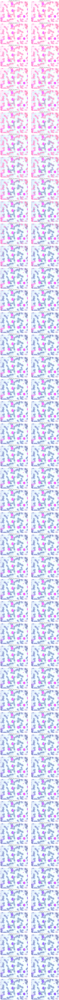

In [359]:
import cv2
import numpy as np
import matplotlib.pyplot as plt

# Charger l'image en RGB
image_rgb = cv2.imread(r"E:\projet_cv\Blood cell Cancer [ALL]\[Malignant] early Pre-B\Sap_148 (1).jpg")

# Convertir l'image RGB en LAB
image_lab = cv2.cvtColor(image_rgb, cv2.COLOR_BGR2LAB)

# Extraire le canal A
channel_A = image_lab[:, :, 1]

# Définir les valeurs pour la recherche par grille
threshold_values = range(120, 180, 2)
kernels = [(3, 3), (5, 5), (7, 7)]

# Calculer le nombre total de combinaisons
total_combinations = len(threshold_values) * len(kernels)

# Calculer le nombre de lignes nécessaire
num_rows = total_combinations // 2
if total_combinations % 2 != 0:
    num_rows += 1

# Préparer la disposition de l'affichage
fig, axs = plt.subplots(num_rows, 2, figsize=(15, 5*num_rows))

# Compteur pour suivre la position dans la grille
counter = 0

# Parcourir les valeurs des paramètres
for threshold_value in threshold_values:
    for kernel_size in kernels:
        # Calculer l'indice de ligne et de colonne dans la grille
        row = counter // 2
        col = counter % 2

        # Appliquer le seuillage binaire
        _, thresholded_A = cv2.threshold(channel_A, threshold_value, 255, cv2.THRESH_BINARY)

        # Appliquer la transformation morphologique d'ouverture pour supprimer le bruit
        kernel = np.ones(kernel_size, np.uint8)
        opening = cv2.morphologyEx(thresholded_A, cv2.MORPH_OPEN, kernel)

        # Identifier les contours des cellules
        contours, _ = cv2.findContours(opening, cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)

        # Créer un masque pour les cellules malignes
        mask = np.zeros_like(image_rgb)

        # Dessiner les contours des cellules malignes en rouge sur le masque
        cv2.drawContours(mask, contours, -1, (0,0,255), thickness=cv2.FILLED)

        # Fusionner le masque avec l'image originale
        image_with_malignant_cells = cv2.addWeighted(image_rgb, 1, mask, 0.5, 0)

        # Afficher l'image avec les cellules malignes colorées en rouge
        axs[row, col].imshow(cv2.cvtColor(image_with_malignant_cells, cv2.COLOR_BGR2RGB))
        axs[row, col].axis('off')
        axs[row, col].set_title(f"Threshold: {threshold_value}, Kernel: {kernel_size}")

        # Incrémenter le compteur
        counter += 1

# Si le nombre total de combinaisons est impair, la dernière cellule de la dernière ligne doit être vide
if total_combinations % 2 != 0:
    axs[-1, -1].axis('off')

# Afficher l'affichage final
plt.tight_layout()
plt.show()


Alors, visuelement comme resultat; on voit que les valeur entre 140 et 150 sont les meilleurs avec un noyeu de (5,5)

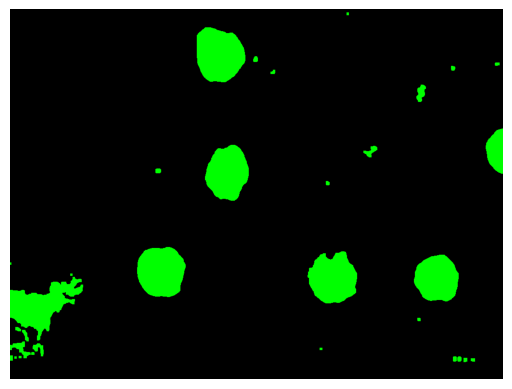

In [360]:
# Charger l'image en RGB
image_rgb = cv2.imread(r"E:\projet_cv\Blood cell Cancer [ALL]\[Malignant] early Pre-B\Sap_148 (1).jpg")

# Convertir l'image RGB en LAB
image_lab = cv2.cvtColor(image_rgb, cv2.COLOR_BGR2LAB)

# Extraire le canal A
channel_A = image_lab[:, :, 1]

# Appliquer le seuillage binaire
_, thresholded_A = cv2.threshold(channel_A, 142, 255, cv2.THRESH_BINARY) 
filled_image = ndi.binary_fill_holes(thresholded_A)
# Convertir l'image booléenne en niveaux de gris
filled_image = filled_image.astype(np.uint8) * 255

# Appliquer la transformation morphologique d'ouverture pour supprimer le bruit
kernel = np.ones((5, 5), np.uint8)
opening = cv2.morphologyEx(filled_image, cv2.MORPH_OPEN, kernel)
cleaned_image = morphology.remove_small_objects(opening, min_size=200)
cleaned_image = morphology.remove_small_holes(cleaned_image, area_threshold=250)
# Identifier les contours des cellules
cleaned_image = cleaned_image.astype(np.uint8) * 255
contours, _ = cv2.findContours(cleaned_image, cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)

# Créer un masque pour les cellules malignes
mask = np.zeros_like(image_rgb)

# Dessiner les contours des cellules malignes
cv2.drawContours(mask, contours, -1, (0,255,0), thickness=cv2.FILLED)

# Fusionner le masque avec l'image originale
image_with_malignant_cells = cv2.addWeighted(image_lab, 1, mask, 0.5, 0)

# Afficher l'image avec les cellules malignes colorées en rouge
plt.imshow(cv2.cvtColor(mask, cv2.COLOR_BGR2RGB))
plt.axis('off')
plt.show()

In [361]:
# Étiqueter les cellules segmentées
labels_thresh = sk_label(opening)

# Extraire les propriétés de chaque cellule
regions_thresh = regionprops(labels_thresh)

# Initialiser des listes pour stocker les caractéristiques
areas = []
perimeters = []
aspect_ratios = []
colors = []
textures = []

for region in regions_thresh:
    # Morphologique
    areas.append(region.area)
    perimeters.append(region.perimeter)
    aspect_ratios.append(region.major_axis_length / region.minor_axis_length)

    # Color 
    minr, minc, maxr, maxc = region.bbox
    cell = image_rgb[minr:maxr, minc:maxc]
    colors.append(np.mean(cell, axis=(0, 1)))

    # Convertir une cellule en niveaux de gris
    cell_gray = rgb2gray(cell)
    cell_gray_ubyte = img_as_ubyte(cell_gray)
    
    # Texture 
    glcm = graycomatrix(cell_gray_ubyte, [5], [0], 256, symmetric=True, normed=True)
    contrast = graycoprops(glcm, 'contrast')[0, 0]
    textures.append(contrast)


In [362]:
print("Areas: ", areas)
print("Perimeters: ", perimeters)
print("Aspect Ratios: ", aspect_ratios)
print("Colors: ", colors)
print("Textures: ", textures)

Areas:  [30.0, 9076.0, 102.0, 64.0, 79.0, 70.0, 460.0, 2490.0, 7764.0, 323.0, 111.0, 65.0, 8469.0, 8273.0, 7049.0, 15.0, 25.0, 8676.0, 47.0, 85.0, 174.0, 584.0, 328.0, 30.0, 40.0, 66.0, 30.0, 25.0, 83.0, 88.0, 69.0, 60.0]
Perimeters:  [18.0, 363.8061325481598, 35.89949493661167, 28.242640687119284, 31.071067811865476, 32.242640687119284, 98.42640687119285, 226.12489168102786, 344.2914139223983, 92.76955262170047, 36.48528137423857, 27.65685424949238, 349.6639969244288, 380.2914139223983, 317.9066376115481, 12.0, 16.0, 743.7716446627536, 22.82842712474619, 34.48528137423857, 63.21320343559642, 155.84062043356593, 102.8700576850888, 18.0, 20.82842712474619, 30.0, 18.0, 16.0, 31.656854249492376, 31.89949493661166, 29.414213562373096, 27.414213562373096]
Aspect Ratios:  [1.2076147288491197, 1.1480191641500286, 1.271755925345279, 1.5122981346586033, 1.126736186068867, 1.536448139673705, 2.3821857738910466, 2.439715362874407, 1.314521000902557, 1.9925543890903519, 1.2011320104724952, 1.19438

Après avoir extrait les caractéristiques, traçons un rectangle autour de la cellule pour la segmenter du fond.

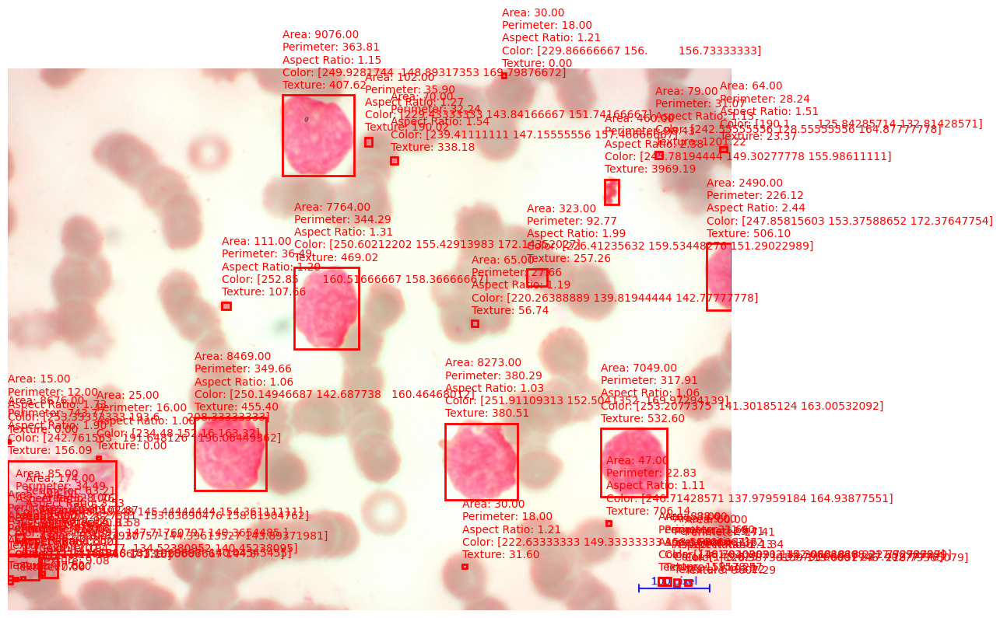

Nombre de cellules malignes : 32


In [363]:
# afficher l'image originale
plt.figure(figsize=(12, 12))
plt.imshow(image_rgb)
plt.axis('off')

# Initialiser le compteur pour les cellules malignes.
malignant_count_thresh = 0

for region, area, perimeter, aspect_ratio, color, texture in zip(regions_thresh, areas, perimeters, aspect_ratios, colors, textures):
        minr, minc, maxr, maxc = region.bbox
        rect = Rectangle((minc, minr), maxc - minc, maxr - minr, fill=False, edgecolor='red', linewidth=2)
        plt.gca().add_patch(rect)
        plt.text(minc, minr - 10, f'Area: {area:.2f}\nPerimeter: {perimeter:.2f}\nAspect Ratio: {aspect_ratio:.2f}\nColor: {color}\nTexture: {texture:.2f}', color='red')
        
        malignant_count_thresh += 1

plt.show()

print(f"Nombre de cellules malignes : {malignant_count_thresh}")

- Comme indiqué, nous segmentons les cellules et traçons un rectangle autour d'elles.
- Bien que la segmentation ne soit pas parfaite, c'est un bon début.
- Le bruit détecté sera bientôt supprimé.

#### Clustering

Une autre technique, c'est de combiner le k-means

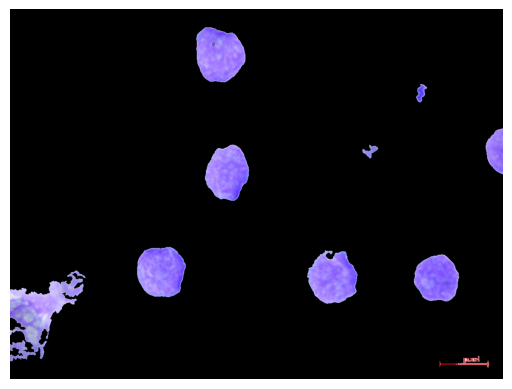

In [9]:
# Charger l'image en RGB
image_rgb = cv2.imread(r"E:\projet_cv\Blood cell Cancer [ALL]\[Malignant] early Pre-B\Sap_148 (1).jpg")
# Convertir l'image RGB en LAB
image_lab = cv2.cvtColor(image_rgb, cv2.COLOR_BGR2LAB)
# Extraire le canal A
canal_A = image_lab[:, :, 1]
# Appliquer le regroupement k-means sur le canal A
canal_a_reshape = canal_A.reshape(-1, 1)
kmeans = KMeans(n_clusters=7, random_state=0).fit(canal_a_reshape)
clustered_a = kmeans.cluster_centers_[kmeans.labels_].reshape(canal_A.shape[0], canal_A.shape[1])
# Appliquer le seuillage binaire
ic = clustered_a.astype(np.uint8)
_, seuil_A = cv2.threshold(ic, 141, 255, cv2.THRESH_BINARY) 
# Combler les trous dans l'image binaire
image_remplie = ndi.binary_fill_holes(seuil_A)
# Supprimer les petits objets et les petits trous
image_nettoyee = morphology.remove_small_objects(image_remplie, min_size=200)
image_nettoyee = morphology.remove_small_holes(image_nettoyee, area_threshold=250)
image_nettoyee = image_nettoyee.astype(np.uint8)
image_sortie = cv2.bitwise_and(image_rgb, image_rgb, mask=image_nettoyee)
# Étiqueter les cellules segmentées
etiquettes = measure.label(image_nettoyee)
# Extraire les propriétés de chaque cellule
regions_knn = measure.regionprops(etiquettes)

# Afficher l'image avec les cellules malignes colorées en rouge
plt.imshow(cv2.cvtColor(image_sortie, cv2.COLOR_BGR2RGB))
plt.axis('off')
plt.show()

In [10]:

areas = []
perimeters = []
aspect_ratios = []
colors = []
textures = []

for region in regions_knn:
    areas.append(region.area)
    perimeters.append(region.perimeter)
    aspect_ratios.append(region.major_axis_length / region.minor_axis_length)

    minr, minc, maxr, maxc = region.bbox
    cell = image_sortie[minr:maxr, minc:maxc]
    colors.append(np.mean(cell, axis=(0, 1)))

    cell_gray = rgb2gray(cell)
    cell_gray_ubyte = img_as_ubyte(cell_gray)
    
    glcm = graycomatrix(cell_gray_ubyte, [5], [0], 256, symmetric=True, normed=True)
    contrast = graycoprops(glcm, 'contrast')[0, 0]
    textures.append(contrast)


In [11]:
print("Areas: ", areas)
print("Perimeters: ", perimeters)
print("Aspect Ratios: ", aspect_ratios)
print("Colors: ", colors)
print("Textures: ", textures)

Areas:  [9118.0, 480.0, 2510.0, 7799.0, 398.0, 8514.0, 8445.0, 7080.0, 12175.0, 643.0]
Perimeters:  [367.4629867976521, 105.74011537017759, 229.29646455628165, 347.94826817189073, 111.8111831820431, 351.6639969244288, 426.9604614807105, 320.3919189857867, 1382.36666581637, 354.77564927611036]
Aspect Ratios:  [1.147625052739048, 2.3939131883749787, 2.441115579527409, 1.312674679810834, 1.6505816999164282, 1.0613397929690147, 1.05420717247198, 1.0633437698013088, 1.8020931556161222, 5.265549567255551]
Colors:  [array([197.77330581, 100.40720674, 124.70235638]), array([136.25057208,  59.15331808,  67.88672769]), array([182.06812865,  91.51695906, 113.54678363]), array([183.89966555,  93.70280565, 113.93905611]), array([95.77115987, 58.89341693, 60.41170324]), array([205.51923077, 101.54007997, 122.99143184]), array([183.96876877,  93.98738739, 113.72904333]), array([194.54168476,  87.17857143, 110.95332175]), array([96.8390456 , 64.92616183, 70.26259563]), array([29.85315534, 27.50121359,

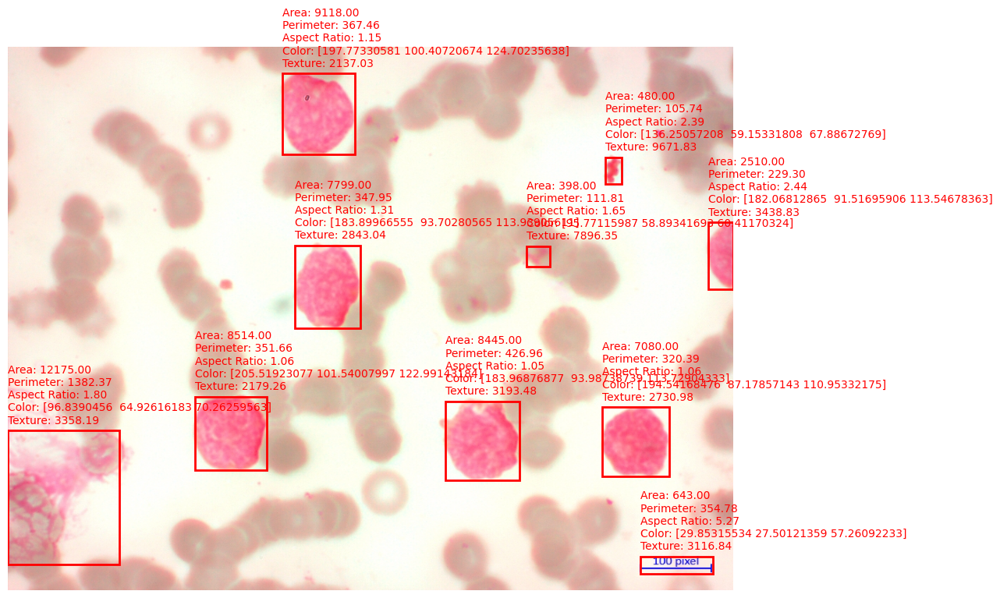

Nombre de cellules malignes : 10


In [12]:
plt.figure(figsize=(12, 12))
plt.imshow(image_rgb)
plt.axis('off')

malignant_count_knn = 0

for region, area, perimeter, aspect_ratio, color, texture in zip(regions_knn, areas, perimeters, aspect_ratios, colors, textures):
        minr, minc, maxr, maxc = region.bbox
        rect = Rectangle((minc, minr), maxc - minc, maxr - minr, fill=False, edgecolor='red', linewidth=2)
        plt.gca().add_patch(rect)
        plt.text(minc, minr - 10, f'Area: {area:.2f}\nPerimeter: {perimeter:.2f}\nAspect Ratio: {aspect_ratio:.2f}\nColor: {color}\nTexture: {texture:.2f}', color='red')
        
        malignant_count_knn += 1

plt.show()

print(f"Nombre de cellules malignes : {malignant_count_knn}")

In [369]:
data = [
    {'technique': 'thresh', 'count': malignant_count_thresh},
    {'technique': 'k-means', 'count': malignant_count_knn},
]

df_cells_counted = pd.DataFrame(data)
print(df_cells_counted)

  technique  count
0    thresh     32
1   k-means     10


Nous pourrions dire que le regroupement K-means fonctionne mieux avec le seuillage, 
- Il ne détecte pas beaucoup de bruit.
- Nous allons donc l'utiliser pour notre segmentation.

## functions utilitaires

In [2]:
"""
PARAMETRES
- image_rgb : Image RGB des cellules
- k : Nombre de clusters pour le regroupement K-means
- threshold_value : Valeur de seuil pour le seuillage binaire
"""
def kmeans_extract_cell_properties(image_rgb, k=7, threshold_value=142):
    # Convertir l'image RGB à l'espace colorimétrique LAB
    image_lab = cv2.cvtColor(image_rgb, cv2.COLOR_RGB2LAB)
    l,a,b = cv2.split(image_lab)                         
        
    # Appliquer le regroupement K-means sur le canal A
    a_reshaped = a.reshape(-1, 1)
    kmeans = KMeans(n_clusters=k, random_state=0).fit(a_reshaped)
    clustered_a = kmeans.cluster_centers_[kmeans.labels_].reshape(a.shape[0], a.shape[1])

    # Appliquer le seuillage binaire au canal A regroupé
    ic = clustered_a.astype(np.uint8)
    _, thresholded_a = cv2.threshold(ic, threshold_value, 255, cv2.THRESH_BINARY)

    # Combler les trous dans l'image binaire
    filled_image = ndi.binary_fill_holes(thresholded_a)

    # Supprimer les petits objets et les petits trous
    cleaned_image = morphology.remove_small_objects(filled_image, min_size=200)
    cleaned_image = morphology.remove_small_holes(cleaned_image, area_threshold=250)
    cleaned_image = cleaned_image.astype(np.uint8)

    # Appliquer la segmentation watershed
    distance = ndi.distance_transform_edt(cleaned_image)
    coords = peak_local_max(distance, min_distance=10, labels=cleaned_image)
    mask = np.zeros(distance.shape, dtype=bool)
    mask[tuple(coords.T)] = True
    markers, _ = ndi.label(mask)
    labels = watershed(-distance, markers, mask=cleaned_image)

    # Extraire les propriétés de chaque cellule
    regions = measure.regionprops(labels)
    return regions, labels

Les caractéristiques que nous allons extraire sont :
- **Aire** : L'aire de la cellule.
- **Périmètre** : Le périmètre de la cellule.
- **Longueur de l'axe majeur** : La longueur de l'axe majeur de la cellule.
- **Longueur de l'axe mineur** : La longueur de l'axe mineur de la cellule.
- **Rapport d'aspect** : Le rapport de la longueur de l'axe majeur à la longueur de l'axe mineur de la cellule.
- **Solidité** : Le rapport de l'aire de la cellule à l'aire de l'enveloppe convexe de la cellule.
- **Diamètre équivalent** : Le diamètre d'un cercle ayant la même aire que la cellule.
- **Étendue** : Le rapport de l'aire de la cellule à l'aire de la boîte englobante de la cellule.
- **Excentricité** : L'excentricité de la cellule.
- **Orientation** : L'angle entre l'axe majeur de la cellule et l'axe x.
- **Intensité moyenne** : L'intensité moyenne de la cellule.
- **Écart-type de l'intensité** : L'écart-type de l'intensité de la cellule.
- **Intensité médiane** : L'intensité médiane de la cellule.
- **Contraste** : Le contraste de la cellule.
- **Corrélation** : La corrélation de la cellule.
- **Énergie** : L'énergie de la cellule.
- **Centroïde** : Les coordonnées du centroïde de la cellule.
- **Boîte englobante** : Les coordonnées de la boîte englobante de la cellule.
- **Aire convexe** : L'aire de l'enveloppe convexe de la cellule.
- **Circularité** : Le rapport du périmètre de la cellule au périmètre d'un cercle ayant la même aire que la cellule.
- **Couleur** : La couleur de la cellule.

In [3]:
def extract_features(region,image_rgb):
    # Morphologique 
    solidity = region.solidity
    eccentricity = region.eccentricity
    orientation = region.orientation
    equivalent_diameter = region.equivalent_diameter
    
    # Couleur 
    minr, minc, maxr, maxc = region.bbox
    cell = image_rgb[minr:maxr, minc:maxc]
    color = np.mean(cell, axis=(0, 1))
    
    # Texture 
    cell_gray = rgb2gray(cell)
    cell_gray_ubyte = img_as_ubyte(cell_gray)
    glcm = graycomatrix(cell_gray_ubyte, [5], [0], 256, symmetric=True, normed=True)
    contrast = graycoprops(glcm, 'contrast')[0, 0]
    
    # Intensité 
    mean_intensity = np.mean(cell)
    median_intensity = np.median(cell)
    std_intensity = np.std(cell)
    correlation = graycoprops(glcm, 'correlation')[0, 0]
    energy = graycoprops(glcm, 'energy')[0, 0]
    
    # Autres 
    centroid = region.centroid
    convex_area = region.convex_area
    bbox_area = region.bbox_area
    bbox = region.bbox
    extent = region.extent
    # filled_area = region.filled_area
    circulatie = region.perimeter ** 2 / (4 * np.pi * region.area)
    
    return {
        "solidity": solidity,
        "eccentricity": eccentricity,
        "orientation": orientation,
        "equivalent_diameter": equivalent_diameter,
        "color": color,
        "contrast": contrast,
        "mean_intensity": mean_intensity,
        "median_intensity": median_intensity,
        "std_intensity": std_intensity,
        "correlation": correlation,
        "energy": energy,
        "centroid": centroid,
        "convex_area": convex_area,
        "bbox_area": bbox_area,
        "extent": extent,
        "circulatie": circulatie,
    }

In [4]:
def process_images(rgb_images, images_label, labeled_features,display_images=False):
    for image_rgb, image_label in zip(rgb_images, images_label):
        # extraire les régions
        regions,output_image= kmeans_extract_cell_properties(image_rgb)
        
        # calculer le nombres de cellules segmentées dans chaque image
        count_cells_in_image = len(regions)
        
        features = []
        
        for region in regions:
            region_features = extract_features(region, image_rgb)
            region_features['cells_in_image'] = count_cells_in_image
            features.append(region_features)
        
        if display_images:
            plt.figure(figsize=(12, 12))
            plt.imshow(output_image)
            plt.title(image_label)
            plt.axis('off')
        
        # tracer un rectangle pour chaque cellule
        for region, region_features in zip(regions, features):
            minr, minc, maxr, maxc = region.bbox
            rect = Rectangle((minc, minr), maxc - minc, maxr - minr, fill=False, edgecolor='red', linewidth=2)
            plt.gca().add_patch(rect)
            floored_color = tuple(map(int, region_features["color"]))
            
            # plt.text(minc, minr - 10, f'Area: {region.area:.2f}\nPerimeter: {region.perimeter:.2f}\nAspect Ratio: {region.major_axis_length / region.minor_axis_length:.2f}\nColor: {floored_color}\nTexture: {region_features["contrast"]:.2f}', color='red')
            region_features["area"] = region.area
            region_features["perimeter"] = region.perimeter
            region_features["aspect_ratio"] = region.major_axis_length / (region.minor_axis_length + 1e-10)
            region_features["label"] = image_label
            labeled_features.append(region_features)
            
        if display_images:
            plt.axis('off')
            plt.show()


## Préparation pour l'entrainement

- enregistre les images ségmentées

In [ ]:
# Initialisation du compteur
compteur = 0

# Pour chaque image dans la liste d'entraînement
for image_path in train_list:
    
    # Charger l'image
    image = cv2.imread(image_path)    
    # Redimensionner l'image à la taille spécifiée
    image = cv2.resize(image, (224, 224))
    # Extraire l'étiquette de l'image
    etiquette = image_path.split(os.path.sep)[3]
    
    #-------- Segmentation ---------
    
    # Convertir l'image en RVB
    image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)
    # Convertir l'image en espace de couleur LAB
    image_lab = cv2.cvtColor(image, cv2.COLOR_RGB2LAB)        
    # Séparer les canaux LAB
    l, a, b = cv2.split(image_lab)                         
    # Réorganiser le canal A pour le clustering
    a_reshape = a.reshape(a.shape[0] * a.shape[1], 1)
    # Appliquer le regroupement K-means
    kmeans = KMeans(n_clusters=7, random_state=0).fit(a_reshape)  
    p2s = kmeans.cluster_centers_[kmeans.labels_]
    ic = p2s.reshape(a.shape[0], a.shape[1])
    ic = ic.astype(np.uint8)
    # Appliquer un seuillage binaire
    r, t = cv2.threshold(ic, 141, 255, cv2.THRESH_BINARY) 
    # Combler les trous dans l'image binaire
    fh = ndi.binary_fill_holes(t)                      
    # Supprimer les petits objets
    m1 = morphology.remove_small_objects(fh, min_size=200)
    # Supprimer les petits trous
    m2 = morphology.remove_small_holes(m1, area_threshold=250)
    m2 = m2.astype(np.uint8)  
    # Appliquer un masque à l'image d'entrée
    out = cv2.bitwise_and(image, image, mask=m2)
    
    # Déterminer le chemin de sauvegarde en fonction de l'étiquette
    if (etiquette == "Benign"):
        chemin_sauvegarde = ('../data/segmented_train/benign/' + etiquette + str(compteur) + '.png') 
    if (etiquette == "[Malignant] Pre-B"):
        chemin_sauvegarde = ('../data/segmented_train/PreB/' + etiquette + str(compteur) + '.png')  
    if (etiquette == "[Malignant] Pro-B"):
        chemin_sauvegarde = ('../data/segmented_train/ProB/' + etiquette + str(compteur) + '.png') 
    if (etiquette == "[Malignant] early Pre-B"):
        chemin_sauvegarde = ('../data/segmented_train/EarlyPreB/' + etiquette + str(compteur) + '.png')
    
    # Incrémenter le compteur
    compteur += 1
    # Convertir l'image en format BGR avant de l'enregistrer
    out = cv2.cvtColor(out, cv2.COLOR_RGB2BGR)
    # Enregistrer l'image segmentée
    cv2.imwrite(chemin_sauvegarde, out)


- la meme chose pour les images de test

In [ ]:
p=0
for img in test_list:
    
    i= cv2.imread(img)    
    i= cv2.resize(i,(224,224))
    label= img.split(os.path.sep)[3]
    
    #-------- Segmentation --------- 
    i= cv2.cvtColor(i, cv2.COLOR_BGR2RGB)
    i_lab = cv2.cvtColor(i, cv2.COLOR_RGB2LAB)        
    l,a,b = cv2.split(i_lab)                         
    i2 = a.reshape(a.shape[0]*a.shape[1],1)
    km= KMeans(n_clusters=7, random_state=0).fit(i2)  
    p2s= km.cluster_centers_[km.labels_]
    ic= p2s.reshape(a.shape[0],a.shape[1])
    ic = ic.astype(np.uint8)
    r,t = cv2.threshold(ic,141,255 ,cv2.THRESH_BINARY) 
    fh = ndi.binary_fill_holes(t)                      
    m1 = morphology.remove_small_objects(fh, 200)
    m2 = morphology.remove_small_holes(m1,250)
    m2 = m2.astype(np.uint8)  
    out = cv2.bitwise_and(i, i, mask=m2)
    
    if (label=="Benign"):
        b= ('../data/segmented_test/benign/'+label+str(p)+'.png') 
    if (label=="[Malignant] Pre-B"):
        b= ('../data/segmented_test/PreB/'+label+str(p)+'.png')  
    if (label=="[Malignant] Pro-B"):
        b= ('../data/segmented_test/ProB/'+label+str(p)+'.png') 
    if (label=="[Malignant] early Pre-B"):
        b= ('../data/segmented_test/EarlyPreB/'+label+str(p)+'.png')
    p+=1
    out= cv2.cvtColor(out, cv2.COLOR_RGB2BGR)
    cv2.imwrite(b,out)

Afficher quelque exemples d'images avec les étapes de segmentation

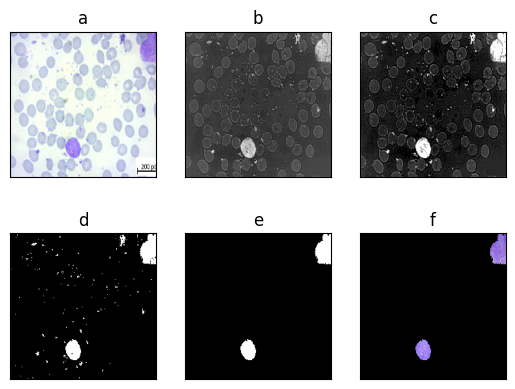

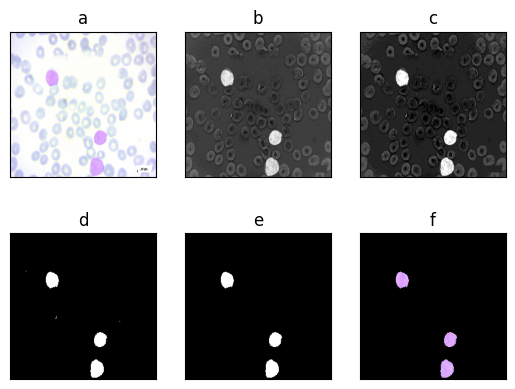

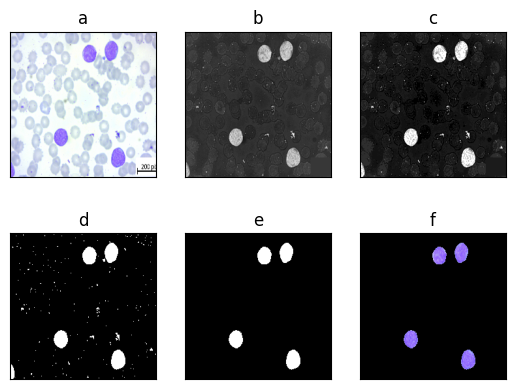

In [10]:
# Nombre d'images à traiter
nb_images = 3

# Listes pour stocker les différentes images et résultats
images_originales = []
images_canal_a = []
images_cluster = []
images_seuillage = []
images_morphologie = []
images_segmentees = []

# Sélection aléatoire des images
images_random = random.sample(data_list, nb_images)

# Parcourir les n premières images de la liste
for image_path in images_random:
    # Charger l'image
    image = cv2.imread(image_path)    
    # Convertir l'image en RVB
    image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)
    # Redimensionner l'image
    image = cv2.resize(image, (224, 224))
    # Ajouter l'image originale à la liste
    images_originales.append(image)
    # Convertir l'image en espace de couleur LAB
    image_lab = cv2.cvtColor(image, cv2.COLOR_RGB2LAB)
    # Séparer les canaux LAB
    l, a, b = cv2.split(image_lab)
    # Ajouter le canal A à la liste
    images_canal_a.append(a)
    # Réorganiser le canal A pour le clustering
    a_reshape = a.reshape(a.shape[0] * a.shape[1], 1)
    # Appliquer le regroupement K-means
    kmeans = KMeans(n_clusters=7, random_state=0).fit(a_reshape)
    # Récupérer les centres de clusters
    p2s = kmeans.cluster_centers_[kmeans.labels_]
    # Réorganiser les clusters
    ic = p2s.reshape(a.shape[0], a.shape[1])
    # Convertir en type de données uint8
    ic = ic.astype(np.uint8)
    # Ajouter l'image du cluster à la liste
    images_cluster.append(ic)
    # Appliquer un seuillage binaire
    r, t = cv2.threshold(ic, 141, 255, cv2.THRESH_BINARY)
    # Ajouter l'image seuillée à la liste
    images_seuillage.append(t)
    # Combler les trous dans l'image binaire
    fh = ndi.binary_fill_holes(t)
    # Supprimer les petits objets
    m1 = morphology.remove_small_objects(fh, min_size=200)
    # Supprimer les petits trous
    m2 = morphology.remove_small_holes(m1, area_threshold=250)
    # Convertir en type de données uint8
    m2 = m2.astype(np.uint8)
    # Ajouter l'image après morphologie à la liste
    images_morphologie.append(m2)
    # Appliquer un masque à l'image originale
    out = cv2.bitwise_and(image, image, mask=m2)
    # Ajouter l'image segmentée à la liste
    images_segmentees.append(out)

# Afficher les images
for j in range(nb_images):    
    for t in range(1):
        plt.subplot(2, 3, 1 + t), plt.imshow(images_originales[j])
        plt.title('a'), plt.xticks([]), plt.yticks([])
        plt.subplot(2, 3, 2 + t), plt.imshow(images_canal_a[j], 'gray')
        plt.title('b'), plt.xticks([]), plt.yticks([])
        plt.subplot(2, 3, 3 + t), plt.imshow(images_cluster[j], 'gray')
        plt.title('c'), plt.xticks([]), plt.yticks([])
        plt.subplot(2, 3, 4 + t), plt.imshow(images_seuillage[j], 'gray')
        plt.title('d'), plt.xticks([]), plt.yticks([])
        plt.subplot(2, 3, 5 + t), plt.imshow(images_morphologie[j], 'gray')
        plt.title('e'), plt.xticks([]), plt.yticks([])
        plt.subplot(2, 3, 6 + t), plt.imshow(images_segmentees[j])
        plt.title('f'), plt.xticks([]), plt.yticks([])
    plt.show()      

In [11]:
segmented_data_path = r'..\data\segmented_train'
segmented_data_list_filenames = (sorted(list(paths.list_images(segmented_data_path))))
random.shuffle(segmented_data_list_filenames)
segmented_data_list_labels = []

for line in segmented_data_list_filenames:
    segmented_data_list_labels.append(line.split(os.path.sep)[3])

I_series = pd.Series(segmented_data_list_filenames, name='filenames')
L_series = pd.Series(segmented_data_list_labels, name='labels')
segmented_train_df = pd.concat( [I_series, L_series], axis=1) 

print('-- image segmentées --')
print(segmented_train_df.head())

print('\n')
print("-- Nombre de chaque cetegorie --")
a = segmented_train_df['labels'].value_counts()      
a

-- image segmentées --
                                           filenames     labels
0  ..\data\segmented_train\ProB\[Malignant] Pro-B...       ProB
1  ..\data\segmented_train\PreB\[Malignant] Pre-B...       PreB
2      ..\data\segmented_train\benign\Benign1321.png     benign
3  ..\data\segmented_train\ProB\[Malignant] Pro-B...       ProB
4  ..\data\segmented_train\EarlyPreB\[Malignant] ...  EarlyPreB


-- Nombre de chaque cetegorie --


labels
EarlyPreB    774
PreB         766
ProB         638
benign       415
Name: count, dtype: int64

In [12]:
segmented_data_path = r'..\data\segmented_test'
segmented_data_list_filenames = (sorted(list(paths.list_images(segmented_data_path))))
random.shuffle(segmented_data_list_filenames)
segmented_data_list_labels = []

for line in segmented_data_list_filenames:
    segmented_data_list_labels.append(line.split(os.path.sep)[3])

I_series = pd.Series(segmented_data_list_filenames, name='filenames')
L_series = pd.Series(segmented_data_list_labels, name='labels')
segmented_test_df = pd.concat( [I_series, L_series], axis=1) 

print('-- image segmentées --')
print(segmented_test_df.head())

print('\n')
print("-- Nombre de chaque cetegorie --")
a = segmented_test_df['labels'].value_counts()      
a

-- image segmentées --
                                           filenames     labels
0  ..\data\segmented_test\EarlyPreB\[Malignant] e...  EarlyPreB
1  ..\data\segmented_test\ProB\[Malignant] Pro-B2...       ProB
2  ..\data\segmented_test\EarlyPreB\[Malignant] e...  EarlyPreB
3  ..\data\segmented_test\PreB\[Malignant] Pre-B4...       PreB
4  ..\data\segmented_test\ProB\[Malignant] Pro-B2...       ProB


-- Nombre de chaque cetegorie --


labels
EarlyPreB    205
PreB         189
ProB         158
benign        97
Name: count, dtype: int64

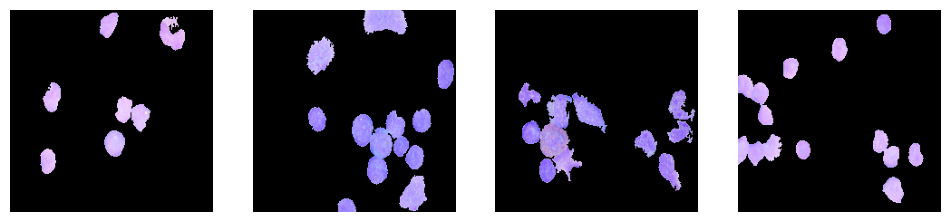

In [14]:
fig = plt.figure(figsize=(12, 12))  
for index, img in enumerate(segmented_train_df['filenames'][:4]):
    i = cv2.imread(img)
    plt.subplot(1, 4, index+1) 
    plt.imshow(cv2.cvtColor(i, cv2.COLOR_BGR2RGB)) 
    plt.axis('off')

plt.show()

## Extraire les caractéristiques

Exemples des images avec les caractéristiques extraites

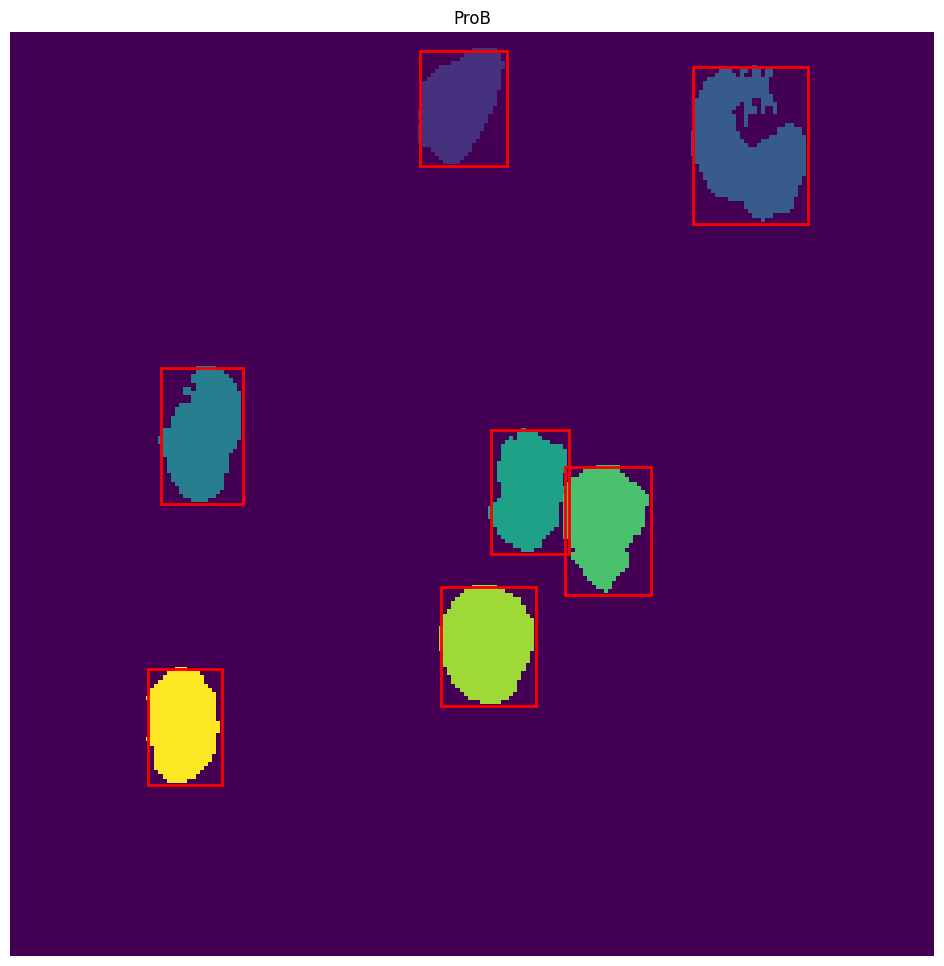

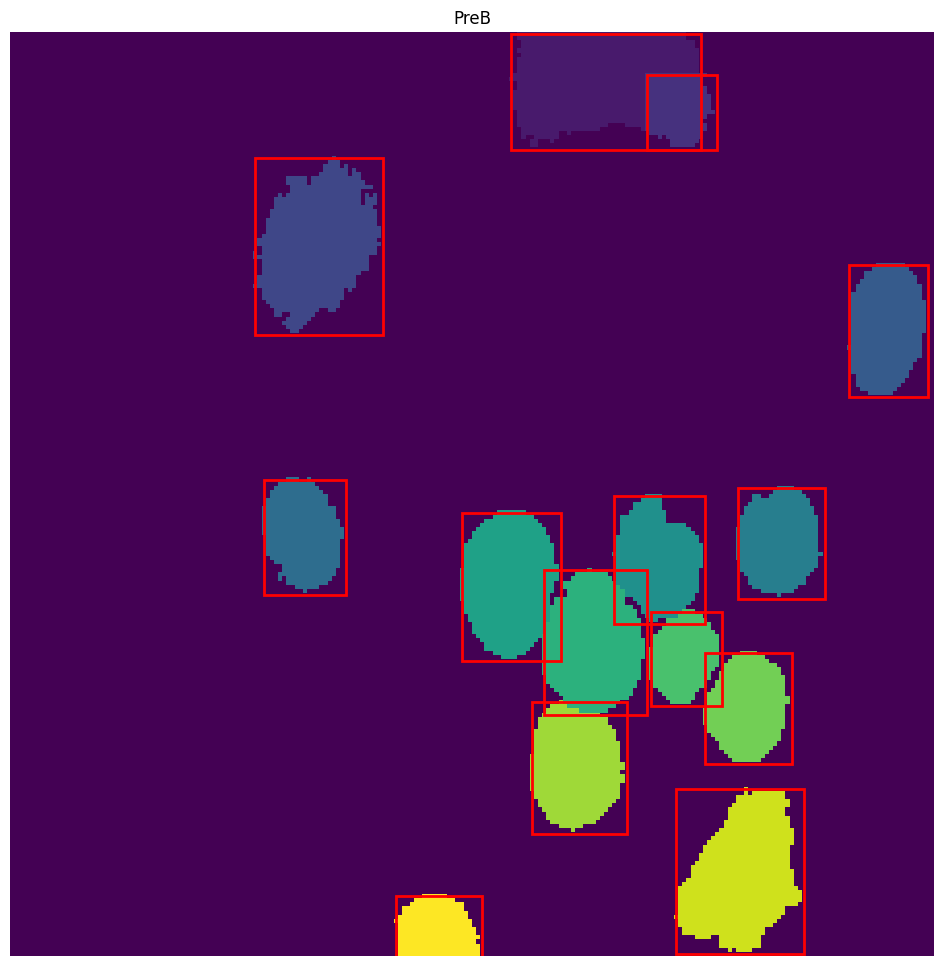

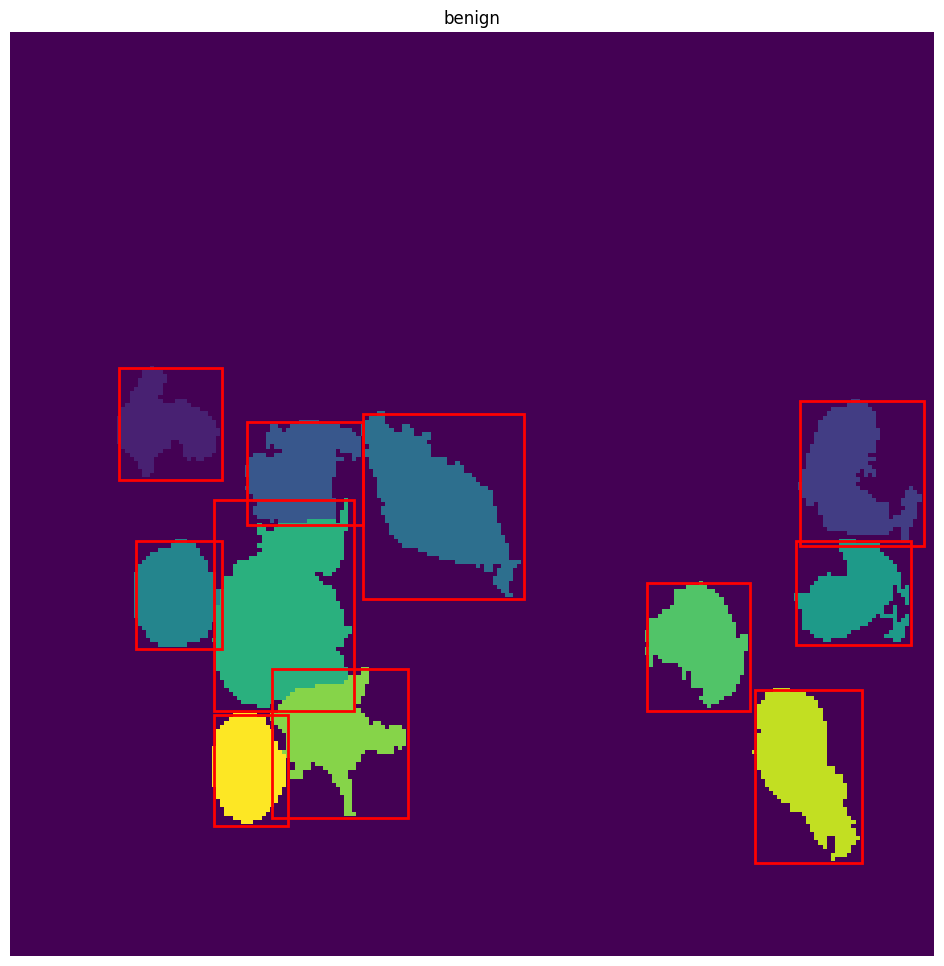

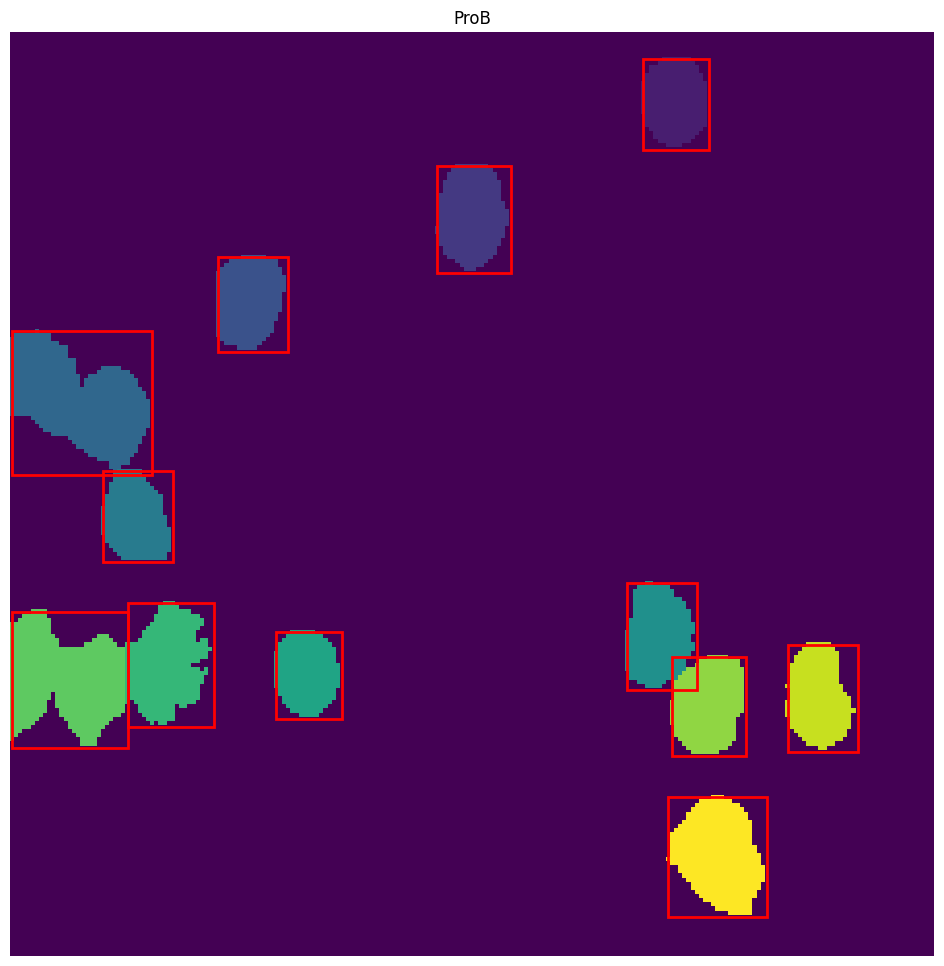

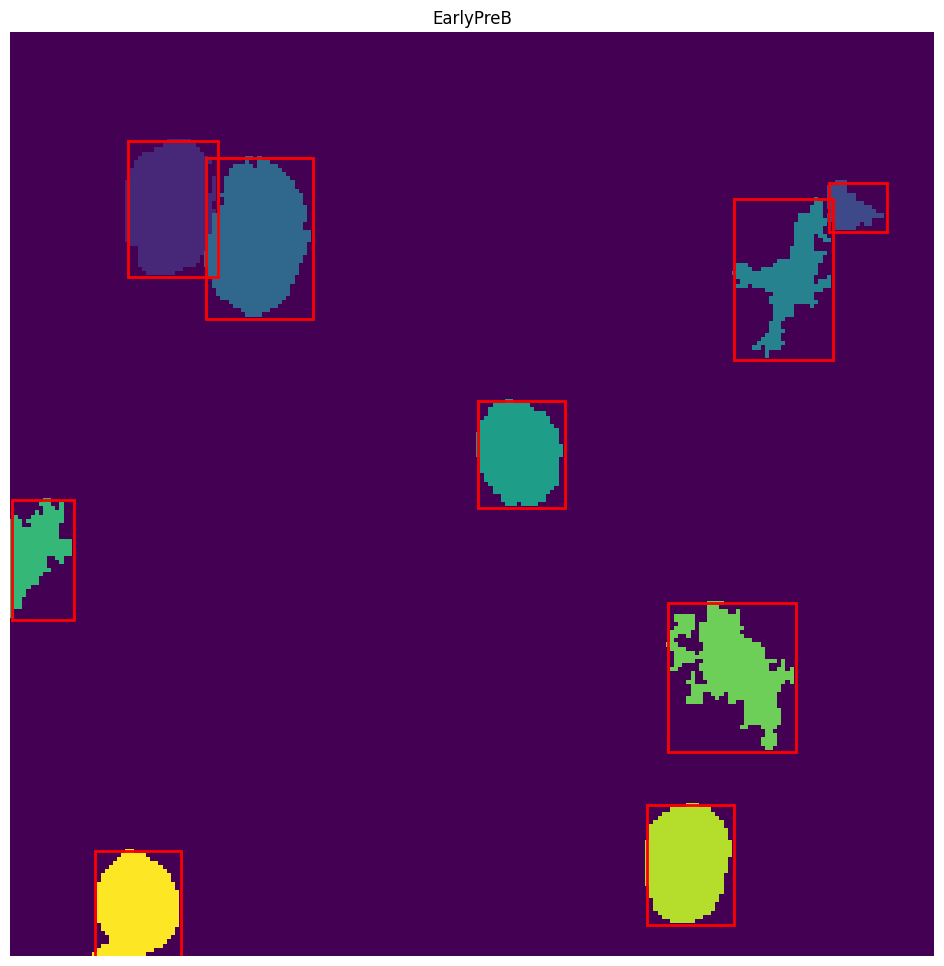

In [18]:
labeled_features_example = []
process_images([cv2.imread(img) for img in segmented_train_df['filenames'][:5]], segmented_train_df['labels'][:5], labeled_features_example,True)

Maintenant, extrayons les caractéristiques des images et stockons-les dans un DataFrame.

KeyboardInterrupt: 

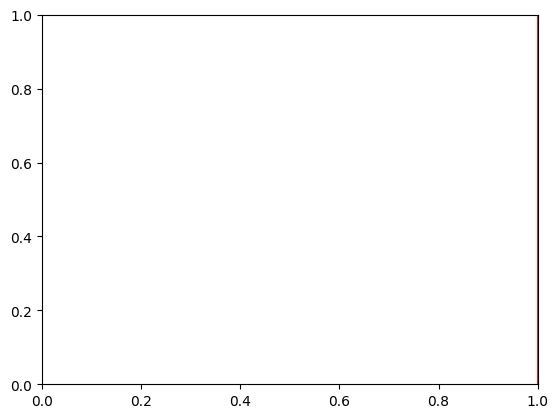

In [17]:
labeled_features_train = []
process_images([cv2.imread(img) for img in segmented_train_df['filenames']], segmented_train_df['labels'], labeled_features_train)

In [ ]:
labeled_features_test = []
process_images([cv2.imread(img) for img in segmented_test_df['filenames']], segmented_test_df['labels'], labeled_features_test)

In [196]:
train_df = pd.DataFrame(labeled_features_train)
train_df.head()

,solidity,eccentricity,orientation,equivalent_diameter,color,contrast,mean_intensity,median_intensity,std_intensity,correlation,...,centroid,convex_area,bbox_area,extent,circulatie,cells_in_image,area,perimeter,aspect_ratio,label
0,0.962448,0.550764,0.120932,29.683021,"[188.22186147186147, 108.21320346320347, 126.5...",6389.495389,140.978716,157.0,91.317655,0.293718,...,"(157.21387283236993, 151.95809248554914)",719.0,924.0,0.748918,1.111783,1,692.0,98.325902,1.198091,PreB
1,0.939597,0.670300,-0.394222,23.124892,"[199.03703703703704, 105.63468013468014, 126.6...",6196.002179,143.783951,155.0,87.261304,0.187419,...,"(34.77857142857143, 114.52380952380952)",447.0,594.0,0.707071,1.225570,5,420.0,80.426407,1.347545,EarlyPreB
2,0.961853,0.665590,-0.333341,21.200320,"[214.10745614035088, 106.74342105263158, 130.5...",5333.193452,150.470760,150.0,81.815559,0.001634,...,"(46.934844192634564, 129.0084985835694)",367.0,456.0,0.774123,1.076790,5,353.0,69.112698,1.339912,EarlyPreB
3,0.960573,0.616553,-0.217115,26.123866,"[203.06146926536732, 115.9985007496252, 134.31...",6046.574713,151.124938,161.0,86.170689,0.183729,...,"(85.51305970149254, 62.46455223880597)",558.0,667.0,0.803598,1.126648,5,536.0,87.112698,1.270142,EarlyPreB
4,0.963415,0.577798,-0.279461,24.566553,"[202.05050505050505, 106.32659932659932, 124.9...",5860.076253,144.429293,151.0,86.642118,0.138914,...,"(141.88396624472574, 72.54008438818565)",492.0,594.0,0.797980,1.095235,5,474.0,80.769553,1.225220,EarlyPreB


In [197]:
test_df = pd.DataFrame(labeled_features_test)
test_df.head()

,solidity,eccentricity,orientation,equivalent_diameter,color,contrast,mean_intensity,median_intensity,std_intensity,correlation,...,centroid,convex_area,bbox_area,extent,circulatie,cells_in_image,area,perimeter,aspect_ratio,label
0,0.835664,0.857509,-0.372227,24.669992,"[135.81597222222223, 69.27199074074075, 102.74...",7435.740057,102.610725,107.0,100.099095,0.372787,...,"(13.560669456066945, 167.00627615062763)",572.0,864.0,0.553241,1.683581,9,478.0,100.562446,1.943749,benign
1,0.964093,0.621224,-0.058646,26.148224,"[188.02463768115942, 85.19565217391305, 118.89...",6229.462963,130.706280,142.0,86.906673,0.000273,...,"(15.2756052141527, 133.0167597765363)",557.0,690.0,0.778261,1.106901,9,537.0,86.426407,1.276108,benign
2,0.959259,0.647378,0.120947,18.159544,"[173.57440476190476, 73.12797619047619, 110.13...",6195.064935,118.946429,129.0,83.146953,-0.129597,...,"(32.42084942084942, 208.55984555984557)",270.0,336.0,0.770833,1.095007,9,259.0,59.698485,1.312044,benign
3,0.973978,0.773929,-0.304027,18.264412,"[186.57101449275362, 55.34202898550725, 93.463...",5311.486957,111.792271,107.0,92.088502,-0.002098,...,"(44.31679389312977, 139.1793893129771)",269.0,345.0,0.759420,1.082469,9,262.0,59.698485,1.579099,benign
4,0.933610,0.672264,0.150458,16.925688,"[184.59, 54.803333333333335, 92.02]",5773.750000,110.471111,106.5,91.868676,-0.124195,...,"(59.53777777777778, 86.44)",241.0,300.0,0.750000,1.143865,9,225.0,56.870058,1.350783,benign


Concaténation des données d'entraînement et de test pour faciliter les traitements ultérieurs.

In [198]:
combined_df = pd.concat([train_df, test_df], keys=['train', 'test'])

In [199]:
combined_df

solidity  eccentricity  orientation  equivalent_diameter  \
train 0     0.962448      0.550764     0.120932            29.683021   
      1     0.939597      0.670300    -0.394222            23.124892   
      2     0.961853      0.665590    -0.333341            21.200320   
      3     0.960573      0.616553    -0.217115            26.123866   
      4     0.963415      0.577798    -0.279461            24.566553   
...              ...           ...          ...                  ...   
test  7028  0.977208      0.678795     0.127382            20.897875   
      7029  0.951482      0.638995     0.105638            21.200320   
      7030  0.956938      0.569657    -0.144451            15.957691   
      7031  0.796875      0.864405     0.164821            24.174717   
      7032  0.951579      0.395376    -0.906627            23.989670   

                                                        color     contrast  \
train 0     [188.22186147186147, 108.21320346320347, 126.5...  6389.495389   
      1     [199.03703703703704, 105.63468013468014, 126.6...  6196.002179   
      2     [214.10745614035088, 106.74342105263158, 130.5...  5333.193452   
      3     [203.06146926536732, 115.9985007496252, 134.31...  6046.574713   
      4     [202.05050505050505, 106.32659932659932, 124.9...  5860.076253   
...                                                       ...          ...   
test  7028  [206.15046296296296, 101.0300925925926, 107.73...  6415.285256   
      7029  [205.8935185185185, 88.44907407407408, 102.416...  4407.717949   
      7030  [197.07037037037037, 80.9074074074074, 88.0888...  6464.700000   
      7031  [146.88359788359787, 88.26719576719577, 99.444...  9444.508681   
      7032  [210.17217391304348, 113.67478260869565, 121.6...  5537.730435   

            mean_intensity  median_intensity  std_intensity  correlation  ...  \
train 0         140.978716             157.0      91.317655     0.293718  ...   
      1         143.783951             155.0      87.261304     0.187419  ...   
      2         150.470760             150.0      81.815559     0.001634  ...   
      3         151.124938             161.0      86.170689     0.183729  ...   
      4         144.429293             151.0      86.642118     0.138914  ...   
...                    ...               ...            ...          ...  ...   
test  7028      138.304784             130.5      85.856733    -0.131301  ...   
      7029      132.253086             122.0      86.069869     0.128594  ...   
      7030      122.022222             105.0      90.118452    -0.132308  ...   
      7031      111.531746             143.5      95.943511     0.228459  ...   
      7032      148.484058             147.0      81.375219    -0.006182  ...   

                                            centroid convex_area  bbox_area  \
train 0     (157.21387283236993, 151.95809248554914)       719.0      924.0   
      1      (34.77857142857143, 114.52380952380952)       447.0      594.0   
      2      (46.934844192634564, 129.0084985835694)       367.0      456.0   
      3       (85.51305970149254, 62.46455223880597)       558.0      667.0   
      4      (141.88396624472574, 72.54008438818565)       492.0      594.0   
...                                              ...         ...        ...   
test  7028    (191.0408163265306, 161.2128279883382)       351.0      432.0   
      7029   (195.42209631728045, 59.32294617563739)       371.0      432.0   
      7030                         (197.545, 96.055)       209.0      270.0   
      7031  (208.98910675381265, 30.607843137254903)       576.0      756.0   
      7032  (212.66150442477877, 108.90044247787611)       475.0      575.0   

              extent  circulatie  cells_in_image   area   perimeter  \
train 0     0.748918    1.111783               1  692.0   98.325902   
      1     0.707071    1.225570               5  420.0   80.426407   
      2     0.774123    1.076790               5  353.0   69.112698   
    

In [200]:
print("data size:",combined_df.shape)
print("train size:",combined_df.loc['train'].shape)
print("test size:",combined_df.loc['test'].shape)

data size: (35123, 21)
train size: (28090, 21)
test size: (7033, 21)


In [202]:
combined_df['label'].value_counts()

label
PreB         19303
EarlyPreB     7218
ProB          4595
benign        4007
Name: count, dtype: int64

Ces résultats indiquent un déséquilibre entre les classes, ce qui pourrait avoir un impact sur l'entraînement du modèle.

Comme solution nous proposons de faire un sous-échantillonnage des classes majoritaires pour correspondre à la taille de la classe minoritaire la plus petite

In [203]:
from sklearn.utils import resample

# Séparer les données d'entraînement et de test
train_df = combined_df.loc['train']
test_df = combined_df.loc['test']

# Calculer la taille minimale d'échantillon dans les ensembles d'entraînement et de test
min_samples_train = train_df['label'].value_counts().min()
min_samples_test = test_df['label'].value_counts().min()

# Fonction pour rééchantillonner les données
def resample_data(df, min_samples):
    resampled_dfs = []
    for label in df['label'].unique():
        label_df = df[df['label'] == label]
        if len(label_df) > min_samples:
            resampled_df = resample(label_df, replace=False, n_samples=min_samples, random_state=42)
        else:
            resampled_df = label_df
        resampled_dfs.append(resampled_df)
    return pd.concat(resampled_dfs)

# Rééchantillonner les données d'entraînement et de test séparément
resampled_train_df = resample_data(train_df, min_samples_train)
resampled_test_df = resample_data(test_df, min_samples_test)

# Combiner les données d'entraînement et de test rééchantillonnées
balanced_df = pd.concat([resampled_train_df, resampled_test_df], keys=['train', 'test'])

In [204]:
balanced_df['label'].value_counts()

label
PreB         4007
EarlyPreB    4007
ProB         4007
benign       4007
Name: count, dtype: int64

In [205]:
balanced_df.loc['train']['label'].value_counts()

label
PreB         3231
EarlyPreB    3231
ProB         3231
benign       3231
Name: count, dtype: int64

In [206]:
combined_df = balanced_df
combined_df

solidity  eccentricity  orientation  equivalent_diameter  \
train 7857   0.968641      0.766802    -0.052832            18.813840   
      14337  0.967667      0.599860     0.043823            23.097346   
      6043   0.975472      0.453827     0.059663            25.656673   
      7310   0.954023      0.685902    -0.019665            25.180812   
      27721  0.950413      0.764189     0.115931            20.958713   
...               ...           ...          ...                  ...   
test  4937   0.916071      0.796662     0.086620            25.557228   
      2115   0.942857      0.840389    -0.181529            25.104852   
      3734   0.959906      0.740452     0.121088            22.764193   
      3006   0.968170      0.715027    -0.158588            21.557654   
      4450   0.960854      0.745583    -0.118555            26.221162   

                                                         color     contrast  \
train 7857     [219.8, 111.65507246376812, 119.79710144927536]  4743.208696   
      14337  [195.3956043956044, 112.8076923076923, 122.283...  8025.040865   
      6043   [203.82371794871796, 104.82211538461539, 124.3...  5246.303644   
      7310                   [192.1651515151515, 97.15, 110.1]  7062.694118   
      27721  [183.76260504201682, 79.44117647058823, 91.810...  6085.428571   
...                                                        ...          ...   
test  4937   [179.05277777777778, 85.28333333333333, 100.10...  6201.237037   
      2115   [191.26060606060605, 114.1530303030303, 130.57...  7752.824242   
      3734   [193.14473684210526, 87.44360902255639, 112.34...  6503.808673   
      3006   [197.7948717948718, 102.38888888888889, 121.28...  6888.008876   
      4450   [206.97727272727272, 119.3934659090909, 137.17...  6287.441176   

             mean_intensity  median_intensity  std_intensity  correlation  \
train 7857       150.417391             138.0      79.961607     0.010854   
      14337      143.495726             155.0      89.727554     0.055695   
      6043       144.330662             145.5      81.335272    -0.033122   
      7310       133.138384             139.0      89.765362     0.046082   
      27721      118.338235             118.0      91.639310     0.158312   
...                     ...               ...            ...          ...   
test  4937       121.479167             129.0      92.233799     0.280221   
      2115       145.329798             165.0      90.843215     0.154047   
      3734       130.976190             137.0      89.648111    -0.017913   
      3006       140.488604             145.0      88.814000     0.067767   
      4450       154.514205             163.0      85.238734     0.103785   

             ...                                  centroid convex_area  \
train 7857   ...    (41.54676258992806, 69.37410071942446)       287.0   
      14337  ...   (182.2291169451074, 177.60859188544154)       433.0   
      6043   ...   (11.785299806576402, 18.21276595744681)       530.0   
      7310   ...    (40.37550200803213, 28.07429718875502)       522.0   
      27721  ...     (136.768115942029, 76.56521739130434)       363.0   
...          ...                                       ...         ...   
test  4937   ...   (157.52631578947367, 9.009746588693957)       560.0   
      2115   ...   (139.56161616161617, 135.3838383838384)       525.0   
      3734   ...   (192.30712530712532, 38.26289926289926)       424.0   
      3006   ...   (96.24109589041096, 150.56164383561645)       377.0   
      4450   ...  (129.51481481481483, 107.66481481481482)       562.0   

             bbox_area    extent  circulatie  cells_in_image   area  \
train 7857       345.0  0.805797    1.081115              31  278.0   
      14337      546.0  0.767399    1.085417              18  419.0   
      6043       624.0  0.828526    1.063247              19  517.0   
      7310       660.0  0.754545    1.193586              24  498.0   
      27721      4

In [207]:
# Diviser la couleur en R, G, B (rouge, vert, bleu).
combined_df['R'] = combined_df['color'].apply(lambda x: x[0])
combined_df['G'] = combined_df['color'].apply(lambda x: x[1])
combined_df['B'] = combined_df['color'].apply(lambda x: x[2])
combined_df = combined_df.drop('color', axis=1)

# Diviser centroid en x, y
combined_df['centroid_x'] = combined_df['centroid'].apply(lambda x: x[1])
combined_df['centroid_y'] = combined_df['centroid'].apply(lambda x: x[0])
combined_df = combined_df.drop('centroid', axis=1)

In [208]:
# Regrouper par étiquette et calculer la moyenne de la colonne : cells_in_image
combined_df.groupby('label').mean()['cells_in_image']

# Ajouter une autre colonne nommée : avg_cells
combined_df['avg_cells'] = combined_df.groupby('label')['cells_in_image'].transform('mean')

# Supprimer la colonne cells_in_image
combined_df = combined_df.drop('cells_in_image', axis=1)

In [309]:
combined_df.head()

solidity  eccentricity  orientation  equivalent_diameter  \
train 7857   0.968641      0.766802    -0.052832            18.813840   
      14337  0.967667      0.599860     0.043823            23.097346   
      6043   0.975472      0.453827     0.059663            25.656673   
      7310   0.954023      0.685902    -0.019665            25.180812   
      27721  0.950413      0.764189     0.115931            20.958713   

                contrast  mean_intensity  median_intensity  std_intensity  \
train 7857   4743.208696      150.417391             138.0      79.961607   
      14337  8025.040865      143.495726             155.0      89.727554   
      6043   5246.303644      144.330662             145.5      81.335272   
      7310   7062.694118      133.138384             139.0      89.765362   
      27721  6085.428571      118.338235             118.0      91.639310   

             correlation    energy  ...   area  perimeter  aspect_ratio  \
train 7857      0.010854  0.055253  ...  278.0  61.455844      1.557914   
      14337     0.055695  0.064636  ...  419.0  75.597980      1.249836   
      6043     -0.033122  0.049170  ...  517.0  83.112698      1.122222   
      7310      0.046082  0.067455  ...  498.0  86.426407      1.374205   
      27721     0.158312  0.099558  ...  345.0  71.526912      1.550406   

             label           R           G           B  centroid_x  \
train 7857    PreB  219.800000  111.655072  119.797101   69.374101   
      14337   PreB  195.395604  112.807692  122.283883  177.608592   
      6043    PreB  203.823718  104.822115  124.346154   18.212766   
      7310    PreB  192.165152   97.150000  110.100000   28.074297   
      27721   PreB  183.762605   79.441176   91.810924   76.565217   

             centroid_y  avg_cells  
train 7857    41.546763  24.170202  
      14337  182.229117  24.170202  
      6043    11.785300  24.170202  
      7310    40.375502  24.170202  
      27721  136.768116  24.170202  

[5 rows x 24 columns]

In [307]:
combined_df.describe()

,solidity,eccentricity,orientation,equivalent_diameter,contrast,mean_intensity,median_intensity,std_intensity,correlation,energy,...,circulatie,area,perimeter,aspect_ratio,R,G,B,centroid_x,centroid_y,avg_cells
count,16028.000000,16028.000000,16028.000000,16028.000000,16028.000000,16028.000000,16028.000000,16028.000000,16028.000000,16028.000000,...,16028.000000,16028.000000,16028.000000,1.602800e+04,16028.000000,16028.000000,16028.000000,16028.000000,16028.000000,16028.000000
mean,0.918902,0.686722,-0.013808,23.150933,8166.352714,136.987746,152.878837,92.428149,0.150222,0.107097,...,1.416709,442.828238,86.017088,2.270829e+08,182.356424,104.487994,124.118821,113.912826,115.636689,12.220115
std,0.070057,0.129675,0.498901,5.278492,3090.731283,21.220880,39.995190,7.946055,0.182343,0.068842,...,0.597610,202.924143,27.685606,4.223140e+09,23.402720,22.565697,27.157022,59.592827,60.409132,6.986205
min,0.382979,0.000000,-1.570295,1.128379,0.000000,40.618039,0.000000,0.000000,-1.000000,0.000000,...,0.000000,1.000000,0.000000,0.000000e+00,61.045455,23.152074,29.503529,3.145540,3.448598,6.587721
25%,0.909091,0.620657,-0.190928,20.310825,6121.647743,124.982542,136.000000,88.288741,0.030615,0.066898,...,1.121188,324.000000,70.526912,1.275376e+00,173.013678,90.348031,106.626767,66.527775,66.294230,7.989456
50%,0.945205,0.696921,-0.011243,23.042155,7551.826118,136.732209,151.500000,92.087363,0.138128,0.083154,...,1.205475,417.000000,80.787320,1.394413e+00,187.131378,103.250822,119.295965,117.020000,119.417231,9.061268
75%,0.958984,0.768135,0.160183,25.706251,9806.060979,150.678770,178.000000,96.763052,0.253961,0.117170,...,1.451552,519.000000,94.390873,1.561797e+00,196.931228,120.068431,141.041598,161.385263,165.091852,13.291927
max,1.000000,1.000000,1.570796,62.815359,38365.300000,255.000000,255.000000,119.597702,1.000000,0.707107,...,8.180431,3099.000000,326.013239,2.306513e+11,255.000000,255.000000,255.000000,219.329004,219.360515,24.170202


In [308]:
combined_df.info()

<class 'pandas.core.frame.DataFrame'>
MultiIndex: 16028 entries, ('train', 7857) to ('test', 4450)
Data columns (total 24 columns):
 #   Column               Non-Null Count  Dtype  
---  ------               --------------  -----  
 0   solidity             16028 non-null  float64
 1   eccentricity         16028 non-null  float64
 2   orientation          16028 non-null  float64
 3   equivalent_diameter  16028 non-null  float64
 4   contrast             16028 non-null  float64
 5   mean_intensity       16028 non-null  float64
 6   median_intensity     16028 non-null  float64
 7   std_intensity        16028 non-null  float64
 8   correlation          16028 non-null  float64
 9   energy               16028 non-null  float64
 10  convex_area          16028 non-null  float64
 11  bbox_area            16028 non-null  float64
 12  extent               16028 non-null  float64
 13  circulatie           16028 non-null  float64
 14  area                 16028 non-null  float64
 15  perimeter    

Toutes les données sont au bon format.

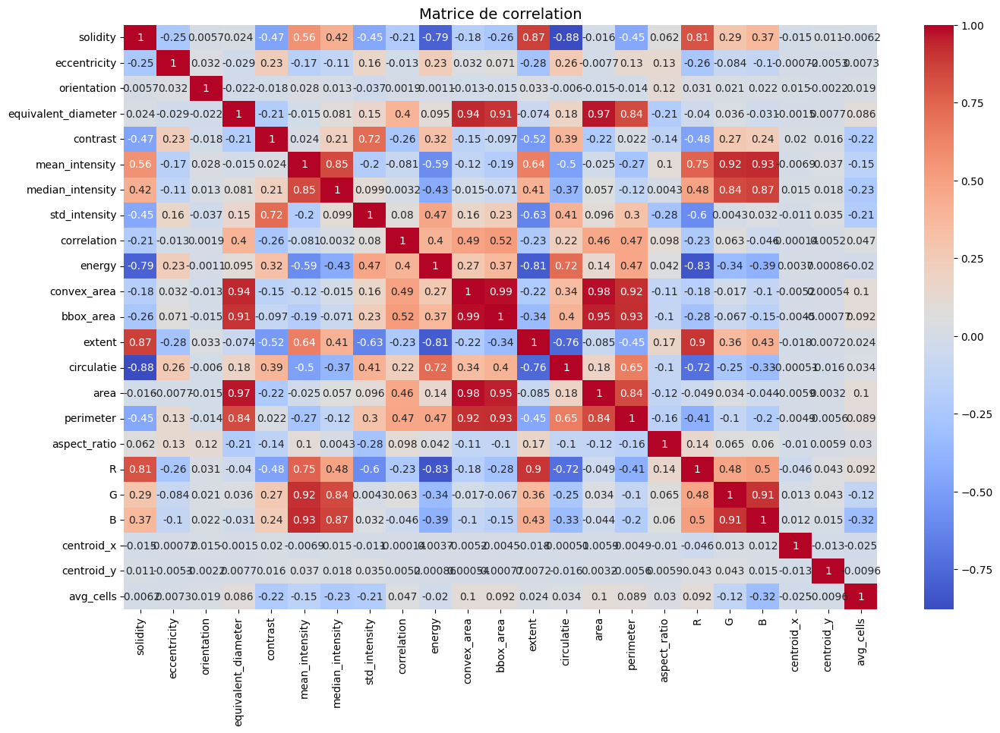

In [209]:
plt.figure(figsize=(16, 10))
sns.heatmap(combined_df.drop(columns=['label', ]).corr(), annot=True, cmap='coolwarm')
plt.title('Matrice de correlation', fontsize=14)
plt.show()

## Mise à l'échelle des données

In [234]:
train_df = combined_df.loc['train']
test_df = combined_df.loc['test']

# Supprimer la colonne d'étiquette avant la mise à l'échelle
train_features = train_df.drop(columns=['label'])
test_features = test_df.drop(columns=['label'])

# Mettre à l'échelle les caractéristiques
scaler = StandardScaler()
scaler.fit(train_features)
scaled_train_features = scaler.transform(train_features)
scaled_test_features = scaler.transform(test_features)

# Convertir les caractéristiques mises à l'échelle en DataFrames
scaled_train_df = pd.DataFrame(scaled_train_features, columns=train_features.columns, index=train_df.index)
scaled_test_df = pd.DataFrame(scaled_test_features, columns=test_features.columns, index=test_df.index)

# Combiner les caractéristiques mises à l'échelle avec les étiquettes et les clés
scaled_train_df['label'] = train_df['label']
scaled_test_df['label'] = test_df['label']

# Combiner les DataFrames d'entraînement et de test en un seul DataFrame avec des clés
scaled_combined_df = pd.concat([scaled_train_df, scaled_test_df], keys=['train', 'test'])

In [310]:
scaled_combined_df.head()

solidity  eccentricity  orientation  equivalent_diameter  \
train 7857   0.710192      0.616203    -0.073933            -0.826363   
      14337  0.696314     -0.671994     0.119467            -0.014285   
      6043   0.807547     -1.798842     0.151161             0.470919   
      7310   0.501842     -0.008051    -0.007568             0.380704   
      27721  0.450392      0.596042     0.263748            -0.419732   

             contrast  mean_intensity  median_intensity  std_intensity  \
train 7857  -1.098226        0.633933         -0.369388      -1.572539   
      14337 -0.043772        0.306969          0.055086      -0.338616   
      6043  -0.936581        0.346409         -0.182120      -1.398977   
      7310  -0.352975       -0.182289         -0.344419      -0.333839   
      27721 -0.666970       -0.881415         -0.868768      -0.097066   

             correlation    energy  ...      area  perimeter  aspect_ratio  \
train 7857     -0.772115 -0.751116  ... -0.815151  -0.887876     -0.056729   
      14337    -0.525104 -0.614769  ... -0.121051  -0.378616     -0.056729   
      6043     -1.014359 -0.839517  ...  0.361374  -0.108010     -0.056729   
      7310     -0.578055 -0.573808  ...  0.267843   0.011317     -0.056729   
      27721     0.040180 -0.107307  ... -0.485330  -0.525215     -0.056729   

                    R         G         B  centroid_x  centroid_y  avg_cells  \
train 7857   1.593164  0.319226 -0.159095   -0.744598   -1.227950    1.71058   
      14337  0.553944  0.370636 -0.067298    1.066720    1.097724    1.71058   
      6043   0.912841  0.014458  0.008829   -1.600790   -1.719948    1.71058   
      7310   0.416381 -0.327739 -0.517054   -1.435756   -1.247313    1.71058   
      27721  0.058573 -1.117599 -1.192177   -0.624254    0.346191    1.71058   

             label  
train 7857    PreB  
      14337   PreB  
      6043    PreB  
      7310    PreB  
      27721   PreB  

[5 rows x 24 columns]

## Méthodes de sélection de caractéristiques pour l'apprentissage automatique
Nous utiliserons la méthode de sélection des caractéristiques suivante pour sélectionner les caractéristiques les plus importantes : la Méthode d'Élimination des Caractéristiques Récursives (RFE) en utilisant la régression logistique.

In [237]:
X = scaled_combined_df.drop(columns=['label'])
y = scaled_combined_df['label']

In [252]:
X_train =scaled_combined_df.loc['train'].drop(columns=['label'])
X_test =  scaled_combined_df.loc['test'].drop(columns=['label'])
y_train = scaled_combined_df.loc['train']['label']
y_test = scaled_combined_df.loc['test']['label']

In [253]:
print(X_train.shape)
print(y_train.shape)

(12924, 23)
(12924,)


In [257]:
# RFE avec LogisticRegression
from sklearn.feature_selection import RFE
from sklearn.linear_model import LogisticRegression

modele = LogisticRegression()
rfe = RFE(estimator=modele, n_features_to_select=5)
fit = rfe.fit(X, y)

# Obtenir les noms de colonnes
noms_caracteristiques = X.columns

# Obtenir les indices des caractéristiques sélectionnées
indices_caracteristiques_selectionnees = fit.support_

# Obtenir les noms des caractéristiques sélectionnées
caracteristiques_selectionnees_rfe = noms_caracteristiques[indices_caracteristiques_selectionnees]

print("Num Features : %d" % fit.n_features_)
print("Selected Features  : ", caracteristiques_selectionnees_rfe)

Num Features: 5
Selected Features:  Index(['equivalent_diameter', 'area', 'R', 'B', 'avg_cells'], dtype='object')


In [260]:
selected_feature_names_rfe = [column for column, mask in zip(X.columns, fit.support_) if mask]
print("Selected Features: ", selected_feature_names_rfe)

Selected Features:  ['equivalent_diameter', 'area', 'R', 'B', 'avg_cells']


Définir une dataframe pour les caractéristiques selectionnées

In [261]:
nouvelles_colonnes = caracteristiques_selectionnees_rfe.tolist()
nouvelles_colonnes.append('label')

# Créer un masque booléen pour les colonnes à supprimer
masque_suppression_colonnes = ~scaled_combined_df.columns.isin(nouvelles_colonnes)

# Obtenir les noms des colonnes à supprimer
colonnes_a_supprimer = scaled_combined_df.columns[masque_suppression_colonnes]

# Supprimer les colonnes
donnees_selectionnees_echellees_df = scaled_combined_df.drop(columns=colonnes_a_supprimer)
selected_scaled_df = scaled_combined_df.drop(columns=colonnes_a_supprimer)

In [263]:
selected_scaled_df

equivalent_diameter      area         R         B  avg_cells  \
train 7857             -0.826363 -0.815151  1.593164 -0.159095   1.710580   
      14337            -0.014285 -0.121051  0.553944 -0.067298   1.710580   
      6043              0.470919  0.361374  0.912841  0.008829   1.710580   
      7310              0.380704  0.267843  0.416381 -0.517054   1.710580   
      27721            -0.419732 -0.485330  0.058573 -1.192177   1.710580   
...                          ...       ...       ...       ...        ...   
test  4937              0.452066  0.341683 -0.141987 -0.886143  -0.538709   
      2115              0.366303  0.253075  0.377863  0.238788  -0.538709   
      3734             -0.077445 -0.180123  0.458095 -0.434358  -0.538709   
      3006             -0.306184 -0.386876  0.656113 -0.104280  -0.538709   
      4450              0.577937  0.474596  1.047130  0.482278  -0.538709   

                 label  
train 7857        PreB  
      14337       PreB  
      6043        PreB  
      7310        PreB  
      27721       PreB  
...                ...  
test  4937   EarlyPreB  
      2115   EarlyPreB  
      3734   EarlyPreB  
      3006   EarlyPreB  
      4450   EarlyPreB  

[16028 rows x 6 columns]

In [264]:
selected_scaled_df.loc['train'].head()

,equivalent_diameter,area,R,B,avg_cells,label
7857,-0.826363,-0.815151,1.593164,-0.159095,1.71058,PreB
14337,-0.014285,-0.121051,0.553944,-0.067298,1.71058,PreB
6043,0.470919,0.361374,0.912841,0.008829,1.71058,PreB
7310,0.380704,0.267843,0.416381,-0.517054,1.71058,PreB
27721,-0.419732,-0.485330,0.058573,-1.192177,1.71058,PreB


## Entrainement

In [265]:
x_train =selected_scaled_df.loc['train'].drop(columns=['label'])
x_test =  selected_scaled_df.loc['test'].drop(columns=['label'])
y_train = selected_scaled_df.loc['train']['label']
y_test = selected_scaled_df.loc['test']['label']

In [266]:
from sklearn.model_selection import cross_val_score,cross_val_predict
from sklearn.ensemble import RandomForestClassifier
from sklearn.naive_bayes import GaussianNB
from sklearn.neighbors import KNeighborsClassifier
from sklearn import svm
from sklearn.metrics import confusion_matrix
from sklearn.metrics import f1_score,precision_score,recall_score,accuracy_score
from sklearn.model_selection import GridSearchCV
from sklearn.tree import DecisionTreeClassifier

### KNN

Best accuracy is 0.9623067010309279 with K = 1


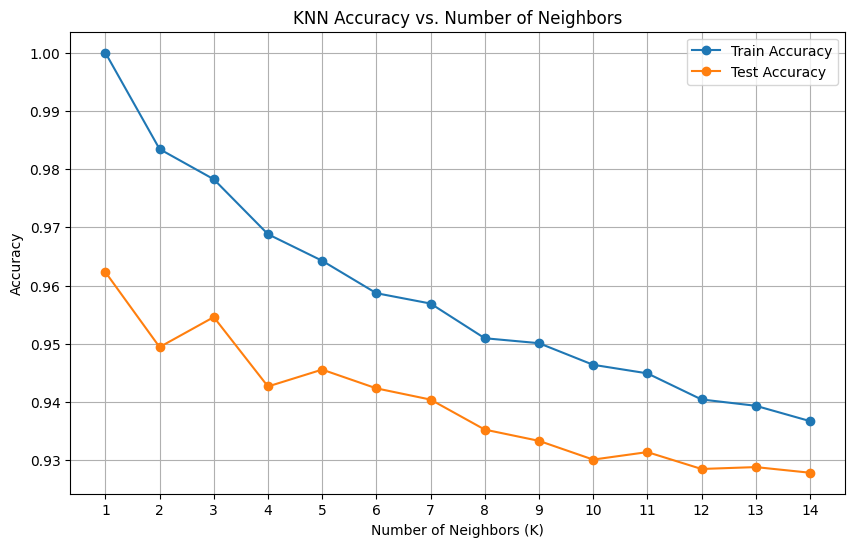

In [267]:
# Générer une plage de valeurs pour K
voisins = np.arange(1, 15)

# Listes pour stocker les scores de précision d'entraînement et de test
precision_entrainement = []
precision_test = []

# Itérer sur différentes valeurs de K
for k in voisins:
    knn = KNeighborsClassifier(n_neighbors=k)
    knn.fit(x_train, y_train)
    precision_entrainement.append(knn.score(x_train, y_train))
    precision_test.append(knn.score(x_test, y_test)) 

# Trouver la valeur de K avec la meilleure précision de test
meilleur_k = np.argmax(precision_test) + 1
meilleure_precision = np.max(precision_test)

print("Best accuracy is {} with K = {}".format(meilleure_precision, meilleur_k))

# Tracer la précision d'entraînement et de test
plt.figure(figsize=(10, 6))
# Tracer la précision d'entraînement et de test
plt.figure(figsize=(10, 6))
plt.plot(neig, train_accuracy, label='Train Accuracy', marker='o')
plt.plot(neig, test_accuracy, label='Test Accuracy', marker='o')
plt.title('KNN Accuracy vs. Number of Neighbors')
plt.xlabel('Number of Neighbors (K)')
plt.ylabel('Accuracy')
plt.xticks(neig)
plt.legend()
plt.grid(True)
plt.show()

In [268]:
knn = KNeighborsClassifier(n_neighbors=best_k)
knn.fit(x_train,y_train)
predicted = knn.predict(x_test)
score = knn.score(x_test, y_test)
knn_score_ = np.mean(score)

accuracy = accuracy_score(y_test, predicted)
print('Accuracy: %.3f' % accuracy)


Accuracy: 0.962


In [269]:
print('Classification report')
print(metrics.classification_report(y_test, predicted))

Classification report
              precision    recall  f1-score   support

   EarlyPreB       0.94      0.92      0.93       776
        PreB       1.00      1.00      1.00       776
        ProB       0.99      0.99      0.99       776
      benign       0.92      0.94      0.93       776

    accuracy                           0.96      3104
   macro avg       0.96      0.96      0.96      3104
weighted avg       0.96      0.96      0.96      3104



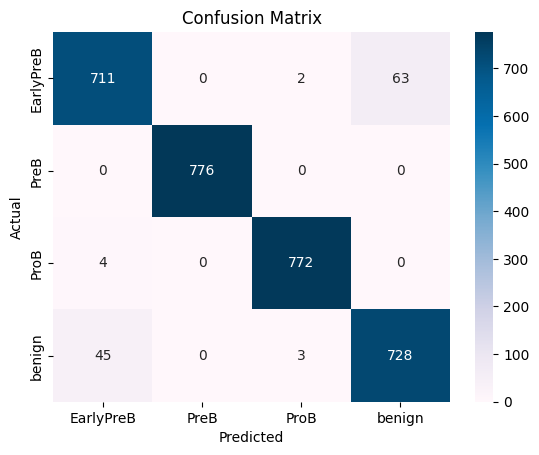

In [270]:
# Calculer la matrice de confusion avec les noms de classe
cf_matrix = confusion_matrix(y_test, predicted, labels=label_encoder.classes_)

# Créer une heatmap de la matrice de confusion avec les noms de classe
sns.heatmap(cf_matrix, cmap="PuBu", annot=True, fmt='.0f', xticklabels=label_encoder.classes_, yticklabels=label_encoder.classes_)
plt.xlabel('Predicted')
plt.ylabel('Actual')
plt.title('Confusion Matrix')
plt.show()


### SVM

In [273]:

param_grid_svm = [
    {"kernel": ["linear"], "C": [1, 10]},
    {"kernel": ["poly"], "C":[1, 10]},
    {"kernel": ["rbf"], "gamma": [1e-3, 1e-4], "C": [1, 10]}
]

SVM_grid = GridSearchCV(svm.SVC(), param_grid_svm, cv=5)
SVM_grid.fit(x_train, y_train)

GridSearchCV(cv=5, estimator=SVC(),
             param_grid=[{'C': [1, 10], 'kernel': ['linear']},
                         {'C': [1, 10], 'kernel': ['poly']},
                         {'C': [1, 10], 'gamma': [0.001, 0.0001],
                          'kernel': ['rbf']}])

In [274]:
print(SVM_grid.best_params_)
 
print(SVM_grid.best_estimator_)

{'C': 1, 'kernel': 'linear'}
SVC(C=1, kernel='linear')


In [275]:
svm_clf = svm.SVC(**SVM_grid.best_params_)
svm_clf.fit(x_train,y_train)
predicted = svm_clf.predict(x_test)
score = svm_clf.score(x_test, y_test)
svm_score_ = np.mean(score)

print('Accuracy : %.3f' % (svm_score_))

print("report ")
print(metrics.classification_report(y_test, predicted))

Accuracy : 1.000
report 
              precision    recall  f1-score   support

   EarlyPreB       1.00      1.00      1.00       776
        PreB       1.00      1.00      1.00       776
        ProB       1.00      1.00      1.00       776
      benign       1.00      1.00      1.00       776

    accuracy                           1.00      3104
   macro avg       1.00      1.00      1.00      3104
weighted avg       1.00      1.00      1.00      3104



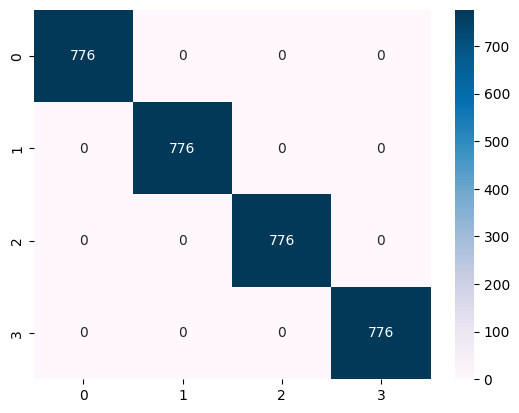

In [276]:
cf_matrix = confusion_matrix(y_test, predicted)
sns.heatmap(cf_matrix, cmap="PuBu", annot=True, fmt='.0f')
plt.show()

### Arbre de decision

In [277]:
param_grid_dt = {
    'max_depth': [None, 10, 20],
    'min_samples_split': [2, 5, 10],
    'min_samples_leaf': [1, 2, 4],
    'criterion': ['gini', 'entropy']
}

dt = DecisionTreeClassifier()

dt_grid = GridSearchCV(estimator=dt, param_grid=param_grid_dt, cv=5)

dt_grid.fit(x_train, y_train)

GridSearchCV(cv=5, estimator=DecisionTreeClassifier(),
             param_grid={'criterion': ['gini', 'entropy'],
                         'max_depth': [None, 10, 20],
                         'min_samples_leaf': [1, 2, 4],
                         'min_samples_split': [2, 5, 10]})

In [278]:

dt = DecisionTreeClassifier(**dt_grid.best_params_, random_state=5)
dt.fit(x_train, y_train)
predicted = dt.predict(x_test)
score = dt.score(x_test, y_test)
dt_score_ = np.mean(score)

print('Accuracy : %.3f' % (dt_score_))

print("report")
print(metrics.classification_report(y_test, predicted))

Accuracy : 1.000
report
              precision    recall  f1-score   support

   EarlyPreB       1.00      1.00      1.00       776
        PreB       1.00      1.00      1.00       776
        ProB       1.00      1.00      1.00       776
      benign       1.00      1.00      1.00       776

    accuracy                           1.00      3104
   macro avg       1.00      1.00      1.00      3104
weighted avg       1.00      1.00      1.00      3104



### Foret aléatoire

In [280]:

param_grid_rf = {
    "n_estimators": [100, 200],
    "criterion": ["gini", "entropy"],
    "max_depth": [None, 10, 20],
}

RF_grid = GridSearchCV(estimator=RandomForestClassifier(), param_grid=param_grid_rf, cv= 5)
RF_grid.fit(x_train, y_train)

GridSearchCV(cv=5, estimator=RandomForestClassifier(),
             param_grid={'criterion': ['gini', 'entropy'],
                         'max_depth': [None, 10, 20],
                         'n_estimators': [100, 200]})

In [281]:
print(RF_grid.best_params_)

{'criterion': 'gini', 'max_depth': None, 'n_estimators': 100}


In [282]:
r_forest = RandomForestClassifier(**RF_grid.best_params_, random_state=5)
r_forest.fit(x_train,y_train)
predicted = r_forest.predict(x_test)
score = r_forest.score(x_test, y_test)
rf_score_ = np.mean(score)

print('Accuracy : %.3f' % (rf_score_))
print("report")
print(metrics.classification_report(y_test, predicted))

Accuracy : 1.000
report
              precision    recall  f1-score   support

   EarlyPreB       1.00      1.00      1.00       776
        PreB       1.00      1.00      1.00       776
        ProB       1.00      1.00      1.00       776
      benign       1.00      1.00      1.00       776

    accuracy                           1.00      3104
   macro avg       1.00      1.00      1.00      3104
weighted avg       1.00      1.00      1.00      3104



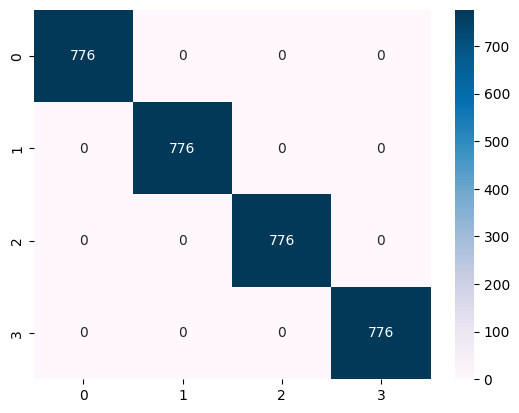

In [283]:
cf_matrix = confusion_matrix(y_test, predicted)
sns.heatmap(cf_matrix, cmap="PuBu", annot=True, fmt='.0f')
plt.show()

Tous les algorithme donnent des bonnes résultats:
- knn avec une précision de 96.2%
- Svm avec une précision de 100%
- Arbre de decision avec une précision de 100%
- Forest Aléatoire avec une précision de 100%

## Export des modèles

In [311]:
import pickle

In [312]:
# 1- knn
with open('../models/knn_model.pkl', 'wb') as file:
    pickle.dump(knn, file)

In [313]:
# 2- SVM 
with open('../models/svm_model.pkl', 'wb') as file:
    pickle.dump(svm_clf, file)

In [314]:
# 3- RF 
with open('../models/rf_model.pkl', 'wb') as file:
    pickle.dump(r_forest, file)

In [315]:
# 4- Dt
with open('../models/dt_model.pkl', 'wb') as file:
    pickle.dump(dt, file)

## Test 

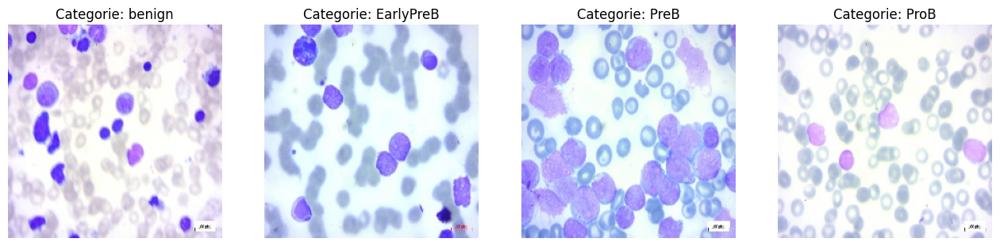

In [316]:
test_data_path = r'C:\projects\Blood-cell-detection\data\test_data'
categories = [category for category in os.listdir(test_data_path) if os.path.isdir(os.path.join(test_data_path, category))]
images_path = []

fig, axs = plt.subplots(1, 4, figsize=(16, 4))

for ax, category in zip(axs, categories):
    if os.listdir(os.path.join(test_data_path, category)):
        random_image = random.choice(os.listdir(os.path.join(test_data_path, category)))
        images_path.append(os.path.join(test_data_path, category, random_image))
        random_image = cv2.imread(os.path.join(test_data_path, category, random_image))
        random_image = cv2.cvtColor(random_image, cv2.COLOR_BGR2RGB)
        ax.imshow(random_image)
        ax.set_title(f"Categorie: {category}")
        ax.axis('off')

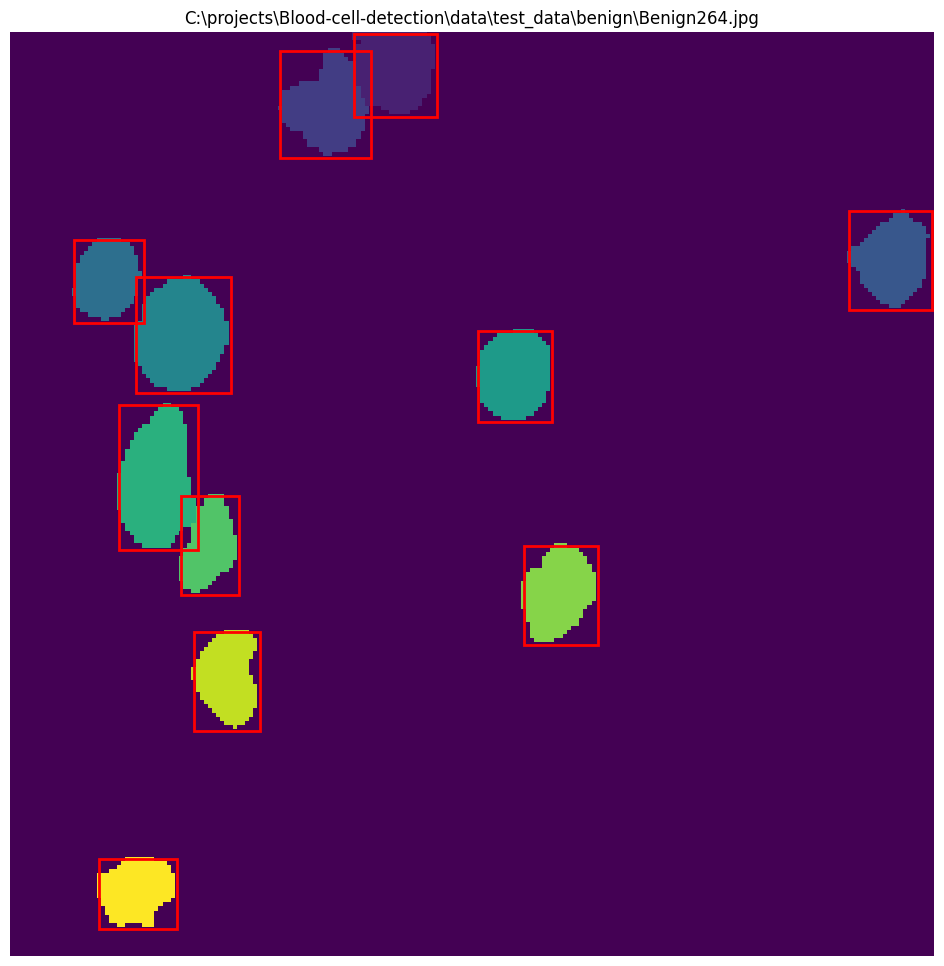

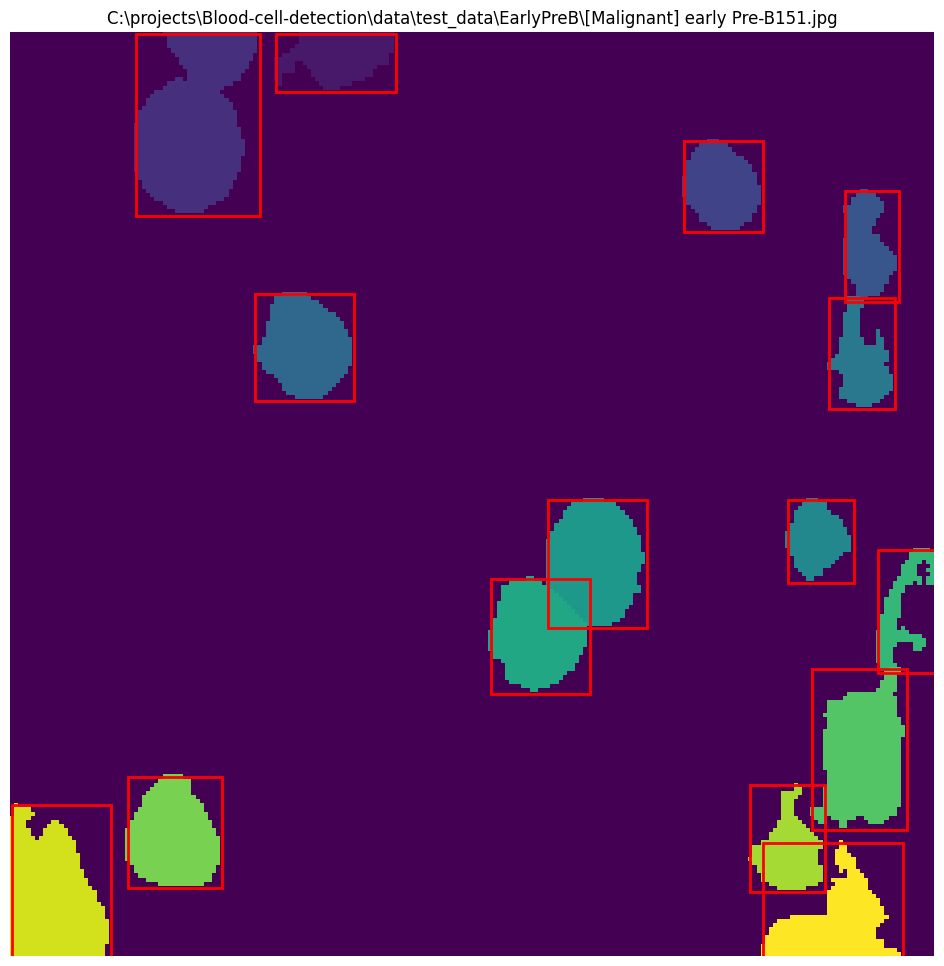

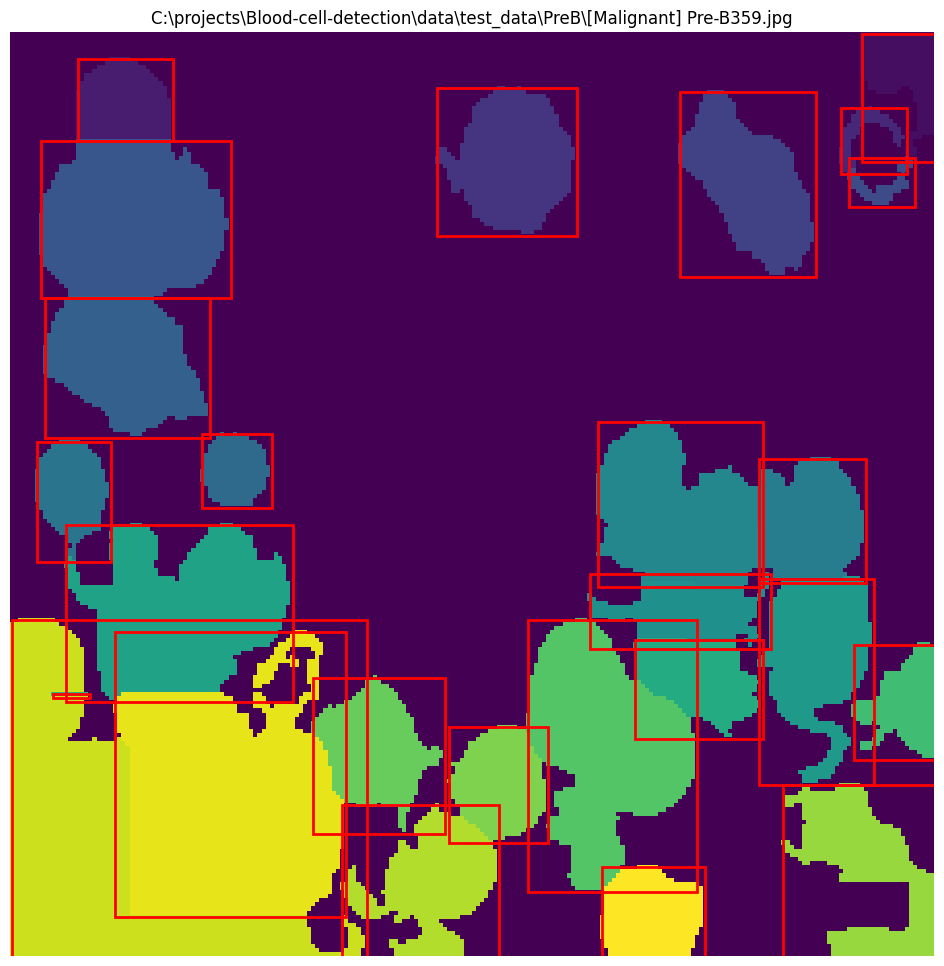

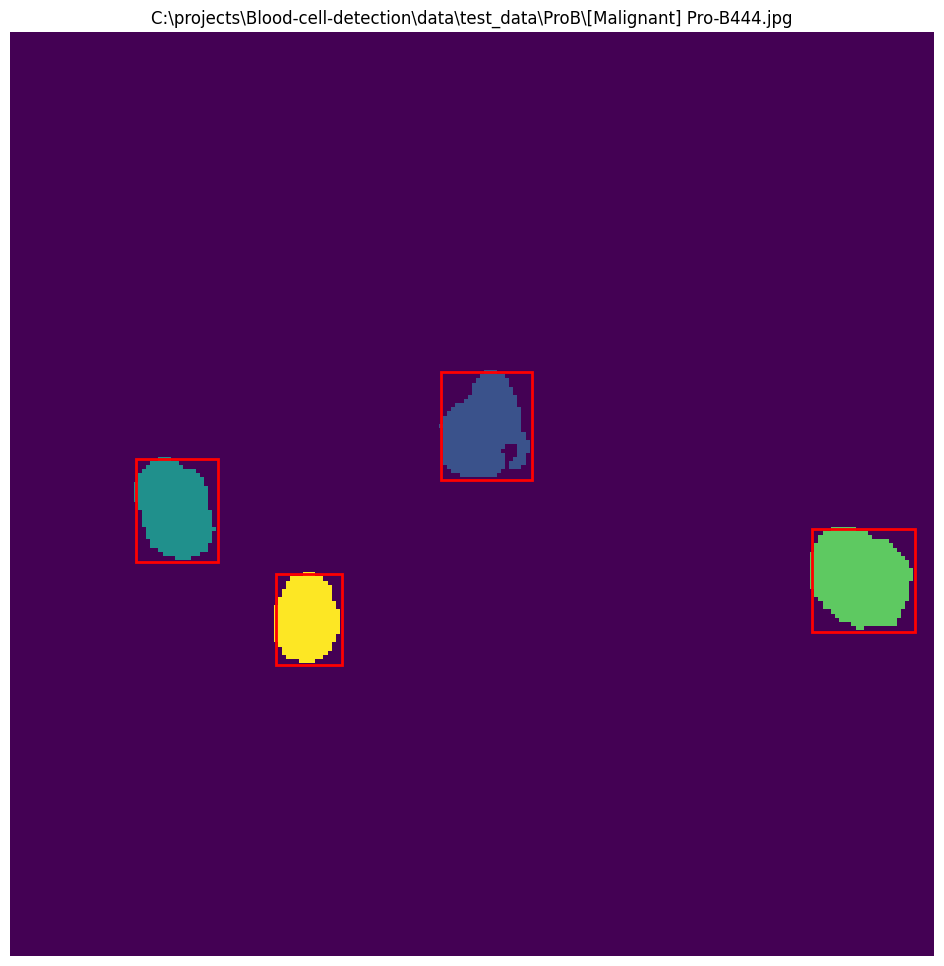

In [317]:

labeled_features_testing = []
process_images([cv2.imread(img) for img in images_path] ,images_path , labeled_features_testing,True)

In [328]:
df_labeled_features_testing = pd.DataFrame(labeled_features_testing)
df_labeled_features_testing.head()

,solidity,eccentricity,orientation,equivalent_diameter,color,contrast,mean_intensity,median_intensity,std_intensity,correlation,...,centroid,convex_area,bbox_area,extent,circulatie,cells_in_image,area,perimeter,aspect_ratio,label
0,0.951289,0.337865,0.271134,20.560047,"[244.345, 129.825, 166.355]",1843.933333,180.175000,172.0,55.622727,-0.186107,...,"(8.596385542168674, 92.7289156626506)",349.0,400.0,0.830000,1.147054,11,332.0,69.177670,1.062480,C:\projects\Blood-cell-detection\data\test_dat...
1,0.871859,0.541052,-0.199054,21.019375,"[244.4562937062937, 137.88636363636363, 162.92...",3501.981900,181.755245,195.0,65.729026,0.308746,...,"(17.538904899135446, 76.54178674351586)",398.0,572.0,0.606643,1.393138,11,347.0,77.941125,1.189076,C:\projects\Blood-cell-detection\data\test_dat...
2,0.943750,0.592188,-0.271298,19.609139,"[226.82708333333332, 130.86666666666667, 151.9...",3921.158333,169.868056,201.0,66.873112,0.352020,...,"(54.7317880794702, 213.4337748344371)",320.0,480.0,0.629167,1.142276,11,302.0,65.840620,1.241003,C:\projects\Blood-cell-detection\data\test_dat...
3,0.943820,0.623469,-0.267024,17.912464,"[246.54117647058823, 140.88529411764705, 187.4...",2413.554167,191.618627,207.0,55.700430,0.134812,...,"(59.357142857142854, 23.0)",267.0,340.0,0.741176,1.072735,11,252.0,58.284271,1.279021,C:\projects\Blood-cell-detection\data\test_dat...
4,0.967936,0.581809,-0.194757,24.798683,"[248.52018633540374, 153.9363354037267, 179.31...",1418.085317,193.922878,188.0,52.649056,0.378199,...,"(72.96894409937889, 40.79710144927536)",499.0,644.0,0.750000,1.065713,11,483.0,80.426407,1.229520,C:\projects\Blood-cell-detection\data\test_dat...


In [329]:
df_labeled_features_testing['R'] = df_labeled_features_testing['color'].apply(lambda x: x[0])
df_labeled_features_testing['G'] = df_labeled_features_testing['color'].apply(lambda x: x[1])
df_labeled_features_testing['B'] = df_labeled_features_testing['color'].apply(lambda x: x[2])
df_labeled_features_testing = df_labeled_features_testing.drop('color', axis=1)

df_labeled_features_testing['centroid_x'] = df_labeled_features_testing['centroid'].apply(lambda x: x[1])
df_labeled_features_testing['centroid_y'] = df_labeled_features_testing['centroid'].apply(lambda x: x[0])
df_labeled_features_testing = df_labeled_features_testing.drop('centroid', axis=1)

In [330]:
df_labeled_features_testing.groupby('label').mean()['cells_in_image']
df_labeled_features_testing['avg_cells'] = df_labeled_features_testing.groupby('label')['cells_in_image'].transform('mean')
df_labeled_features_testing = df_labeled_features_testing.drop('cells_in_image', axis=1)

In [331]:
df_labeled_features_testing.head()

,solidity,eccentricity,orientation,equivalent_diameter,contrast,mean_intensity,median_intensity,std_intensity,correlation,energy,...,area,perimeter,aspect_ratio,label,R,G,B,centroid_x,centroid_y,avg_cells
0,0.951289,0.337865,0.271134,20.560047,1843.933333,180.175000,172.0,55.622727,-0.186107,0.043205,...,332.0,69.177670,1.062480,C:\projects\Blood-cell-detection\data\test_dat...,244.345000,129.825000,166.355000,92.728916,8.596386,11.0
1,0.871859,0.541052,-0.199054,21.019375,3501.981900,181.755245,195.0,65.729026,0.308746,0.035593,...,347.0,77.941125,1.189076,C:\projects\Blood-cell-detection\data\test_dat...,244.456294,137.886364,162.923077,76.541787,17.538905,11.0
2,0.943750,0.592188,-0.271298,19.609139,3921.158333,169.868056,201.0,66.873112,0.352020,0.038390,...,302.0,65.840620,1.241003,C:\projects\Blood-cell-detection\data\test_dat...,226.827083,130.866667,151.910417,213.433775,54.731788,11.0
3,0.943820,0.623469,-0.267024,17.912464,2413.554167,191.618627,207.0,55.700430,0.134812,0.049301,...,252.0,58.284271,1.279021,C:\projects\Blood-cell-detection\data\test_dat...,246.541176,140.885294,187.429412,23.000000,59.357143,11.0
4,0.967936,0.581809,-0.194757,24.798683,1418.085317,193.922878,188.0,52.649056,0.378199,0.034850,...,483.0,80.426407,1.229520,C:\projects\Blood-cell-detection\data\test_dat...,248.520186,153.936335,179.312112,40.797101,72.968944,11.0


In [332]:
drop_columns_mask_test = ~df_labeled_features_testing.columns.isin(selected_feature_names_rfe)
drop_columns_test = df_labeled_features_testing.columns[drop_columns_mask_test]
df_labeled_features_testing = df_labeled_features_testing.drop(columns=drop_columns_test)

In [348]:
df_labeled_features_testing

,equivalent_diameter,area,R,B,avg_cells
0,20.560047,332.0,244.345000,166.355000,11.0
1,21.019375,347.0,244.456294,162.923077,11.0
2,19.609139,302.0,226.827083,151.910417,11.0
3,17.912464,252.0,246.541176,187.429412,11.0
4,24.798683,483.0,248.520186,179.312112,11.0
5,20.248040,322.0,248.292929,170.795455,11.0
6,24.901158,487.0,248.834586,147.001504,11.0
7,16.850294,223.0,245.854167,146.470238,11.0
8,19.867165,310.0,248.636574,203.557870,11.0
9,18.712052,275.0,246.114583,153.158854,11.0


In [334]:
df_labeled_features_testing =  df_labeled_features_testing.drop(columns=['label'])
df_labeled_features_testing.head()

,equivalent_diameter,area,R,B,avg_cells
0,20.560047,332.0,244.345000,166.355000,11.0
1,21.019375,347.0,244.456294,162.923077,11.0
2,19.609139,302.0,226.827083,151.910417,11.0
3,17.912464,252.0,246.541176,187.429412,11.0
4,24.798683,483.0,248.520186,179.312112,11.0


In [335]:
from sklearn.preprocessing import StandardScaler
scaler = StandardScaler()

column_names = df_labeled_features_testing.columns
scaler.fit(df_labeled_features_testing)

scaled_features = scaler.transform(df_labeled_features_testing)


In [336]:
column_names

Index(['equivalent_diameter', 'area', 'R', 'B', 'avg_cells'], dtype='object')

### knn

In [339]:
import pickle

with open('../models/knn_model.pkl', 'rb') as file:
    loaded_model_knn = pickle.load(file)


In [340]:
knn_predictions = loaded_model_knn.predict(df_scaled_features_testing)
knn_predictions

array(['EarlyPreB', 'EarlyPreB', 'EarlyPreB', 'ProB', 'EarlyPreB',
       'EarlyPreB', 'EarlyPreB', 'EarlyPreB', 'ProB', 'EarlyPreB',
       'EarlyPreB', 'benign', 'benign', 'EarlyPreB', 'EarlyPreB',
       'EarlyPreB', 'benign', 'benign', 'EarlyPreB', 'EarlyPreB',
       'EarlyPreB', 'EarlyPreB', 'EarlyPreB', 'benign', 'benign',
       'EarlyPreB', 'PreB', 'PreB', 'PreB', 'PreB', 'PreB', 'PreB',
       'PreB', 'PreB', 'PreB', 'PreB', 'PreB', 'PreB', 'PreB', 'PreB',
       'PreB', 'PreB', 'PreB', 'PreB', 'PreB', 'PreB', 'PreB', 'PreB',
       'PreB', 'PreB', 'PreB', 'PreB', 'ProB', 'ProB', 'ProB', 'ProB'],
      dtype=object)

### svm

In [341]:
with open('../models/svm_model.pkl', 'rb') as file:
    loaded_model_svm = pickle.load(file)

In [342]:
svm_predictions = loaded_model_svm.predict(df_scaled_features_testing)
svm_predictions

array(['ProB', 'ProB', 'ProB', 'ProB', 'ProB', 'ProB', 'ProB', 'ProB',
       'ProB', 'ProB', 'ProB', 'EarlyPreB', 'EarlyPreB', 'EarlyPreB',
       'EarlyPreB', 'EarlyPreB', 'EarlyPreB', 'EarlyPreB', 'EarlyPreB',
       'EarlyPreB', 'EarlyPreB', 'EarlyPreB', 'EarlyPreB', 'EarlyPreB',
       'EarlyPreB', 'EarlyPreB', 'PreB', 'PreB', 'PreB', 'PreB', 'PreB',
       'PreB', 'PreB', 'PreB', 'PreB', 'PreB', 'PreB', 'PreB', 'PreB',
       'PreB', 'PreB', 'PreB', 'PreB', 'PreB', 'PreB', 'PreB', 'PreB',
       'PreB', 'PreB', 'PreB', 'PreB', 'PreB', 'ProB', 'ProB', 'ProB',
       'ProB'], dtype=object)

### Random Forest

In [343]:
with open('../models/rf_model.pkl', 'rb') as file:
    loaded_model_rf = pickle.load(file)

In [344]:
rf_predictions = loaded_model_rf.predict(df_scaled_features_testing)
rf_predictions

array(['ProB', 'ProB', 'ProB', 'ProB', 'ProB', 'ProB', 'ProB', 'ProB',
       'ProB', 'ProB', 'ProB', 'EarlyPreB', 'EarlyPreB', 'EarlyPreB',
       'EarlyPreB', 'EarlyPreB', 'EarlyPreB', 'EarlyPreB', 'EarlyPreB',
       'EarlyPreB', 'EarlyPreB', 'EarlyPreB', 'EarlyPreB', 'EarlyPreB',
       'EarlyPreB', 'EarlyPreB', 'PreB', 'PreB', 'PreB', 'PreB', 'PreB',
       'PreB', 'PreB', 'PreB', 'PreB', 'PreB', 'PreB', 'PreB', 'PreB',
       'PreB', 'PreB', 'PreB', 'PreB', 'PreB', 'PreB', 'PreB', 'PreB',
       'PreB', 'PreB', 'PreB', 'PreB', 'PreB', 'ProB', 'ProB', 'ProB',
       'ProB'], dtype=object)

### Arbre de decision

In [346]:
with open('../models/dt_model.pkl', 'rb') as file:
    loaded_model_dt = pickle.load(file)

rf_predictions = loaded_model_dt.predict(df_scaled_features_testing)
rf_predictions

array(['ProB', 'ProB', 'ProB', 'ProB', 'ProB', 'ProB', 'ProB', 'ProB',
       'ProB', 'ProB', 'ProB', 'EarlyPreB', 'EarlyPreB', 'EarlyPreB',
       'EarlyPreB', 'EarlyPreB', 'EarlyPreB', 'EarlyPreB', 'EarlyPreB',
       'EarlyPreB', 'EarlyPreB', 'EarlyPreB', 'EarlyPreB', 'EarlyPreB',
       'EarlyPreB', 'EarlyPreB', 'PreB', 'PreB', 'PreB', 'PreB', 'PreB',
       'PreB', 'PreB', 'PreB', 'PreB', 'PreB', 'PreB', 'PreB', 'PreB',
       'PreB', 'PreB', 'PreB', 'PreB', 'PreB', 'PreB', 'PreB', 'PreB',
       'PreB', 'PreB', 'PreB', 'PreB', 'PreB', 'ProB', 'ProB', 'ProB',
       'ProB'], dtype=object)

Il semble que tous les modèles rencontrent des difficultés à prédire la classe Benign.